In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
import random
import pandas as pd

In [2]:
class ResidualBlock(nn.Module):
    def __init__(self, input_dim):
        super(ResidualBlock, self).__init__()
        self.fc = nn.Linear(input_dim, input_dim)
        self.layer_norm = nn.LayerNorm(input_dim)
        self.activation = nn.ReLU()

    def forward(self, x):
        identity = x
        out = self.fc(x)
        out = self.layer_norm(out)
        '''out = self.fc(x)
        out = self.layer_norm(out)'''
        out = self.fc(out)
        out = self.activation(out)
        out = out + identity  # Adding the input back to the output
        return out

class VAE(nn.Module):
    def __init__(self, input_dim, hidden_dims, latent_dim):
        super(VAE, self).__init__()
        # Encoder with residual blocks
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, hidden_dims),
            nn.ReLU(),
            ResidualBlock(hidden_dims),
            nn.Dropout(0.2),
            nn.Linear(hidden_dims, hidden_dims),
            nn.ReLU(),
            ResidualBlock(hidden_dims),
            nn.Dropout(0.2),
            ResidualBlock(hidden_dims),
            nn.Linear(hidden_dims, hidden_dims),
            nn.Dropout(0.2),
            nn.ReLU(),
            ResidualBlock (hidden_dims),
            nn.Linear (hidden_dims, hidden_dims),
            nn.ReLU()
        )
        self.fc_mu = nn.Linear(hidden_dims, latent_dim)
        self.fc_log_var = nn.Linear(hidden_dims, latent_dim)

        # Decoder with residual blocks
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, hidden_dims),
            nn.ReLU(),
            ResidualBlock(hidden_dims),
            nn.Dropout(0.2),
            nn.Linear(hidden_dims, hidden_dims),
            nn.ReLU(),
            ResidualBlock(hidden_dims),
            nn.Dropout(0.2),
            nn.Linear(hidden_dims, hidden_dims),
            nn.ReLU(),
            ResidualBlock(hidden_dims),
            nn.Linear(hidden_dims, hidden_dims),
            nn.ReLU(),
            ResidualBlock(hidden_dims),
            nn.Dropout (0.2),
            nn.Linear (hidden_dims, input_dim),
            nn.Sigmoid()
        )

    def encode(self, x):
        h = self.encoder(x)
        mu = self.fc_mu(h)
        log_var = self.fc_log_var(h)
        return mu, log_var

    def reparameterize(self, mu, log_var):
        std = torch.exp(0.5 * log_var)
        eps = torch.randn_like(std)
        return mu + eps * std

    def decode(self, z):
        return self.decoder(z)

    def forward(self, x):
        mu, log_var = self.encode(x.view(-1, num_nodes * 2))
        z = self.reparameterize(mu, log_var)
        return self.decode(z), mu, log_var

def loss_function(recon_x, x, mu, log_var):
    recon_loss = nn.functional.mse_loss(recon_x, x.view(-1, num_nodes * 2), reduction='sum')
    kld_loss = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp())
    return recon_loss + kld_loss

def plot_graph(ax, G, pos):
    nx.draw(G, pos, with_labels=False, node_color = range (num_nodes), cmap = plt.cm.tab20b, edge_color='k',
           node_size = 50, ax = ax)
    
def optimize_layout(G, initial_pos):
    optimized_pos = nx.spring_layout(G, pos=initial_pos, iterations = 50)
    return optimized_pos

In [3]:
def train(model, optimizer, data, epochs = 10):
    model.train()
    loss = None
    for epoch in range(epochs):
        optimizer.zero_grad()
        recon_batch, mu, log_var = model(data)
        loss = loss_function(recon_batch, data, mu, log_var)
        loss.backward()
        optimizer.step()
    print (loss)


In [4]:
def calculate_aesthetic_metrics(positions, edges, min_dist=0.05):
    edge_lengths = torch.stack([torch.norm(positions[e[0]] - positions[e[1]], p=2) for e in edges])
    edge_length_variance = torch.var(edge_lengths)
    node_overlap_count = 0
    n = positions.size(0)
    for i in range(n):
        for j in range(i + 1, n):
            distance = torch.norm(positions[i] - positions[j], p=2)
            if distance < min_dist:
                node_overlap_count += 1
    return edge_length_variance.item(), node_overlap_count

In [5]:
def gen_graphs (num_nodes, p):
    G = nx.fast_gnp_random_graph (n= num_nodes, p = p)
    G.remove_nodes_from (list (nx.isolates(G)))
    prior_labels = list (G)
    labels = list (range (len(list(G))))
    mapping = {prior_labels[i]:labels[i] for i in range (len (labels))}
    nx.relabel_nodes (G, mapping, copy = False)
    return G
    

tensor(0.8927, grad_fn=<AddBackward0>)


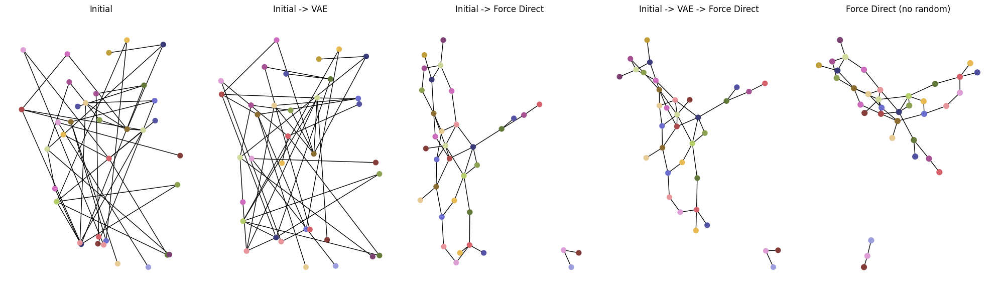

tensor(0.6931, grad_fn=<AddBackward0>)


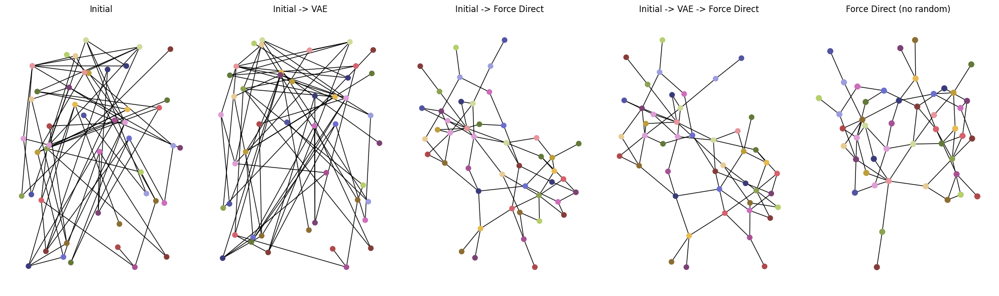

tensor(0.6480, grad_fn=<AddBackward0>)


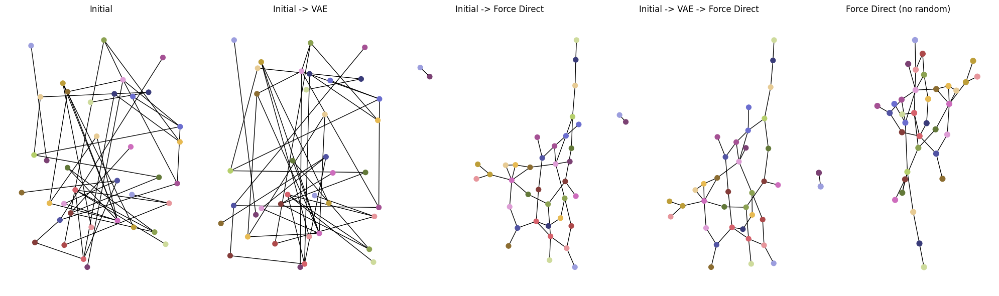

tensor(0.7669, grad_fn=<AddBackward0>)


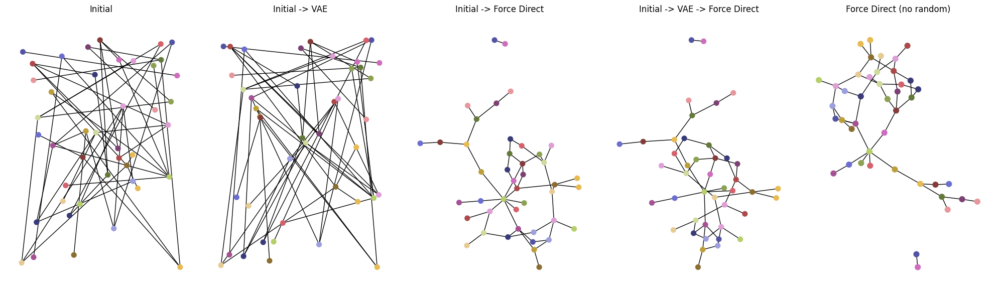

tensor(0.6189, grad_fn=<AddBackward0>)


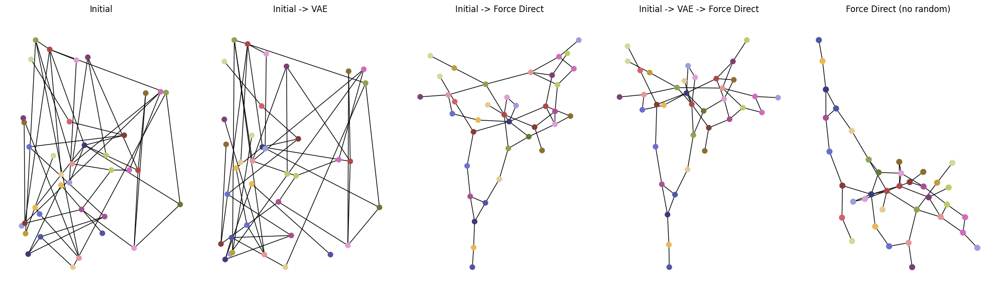

tensor(0.6444, grad_fn=<AddBackward0>)


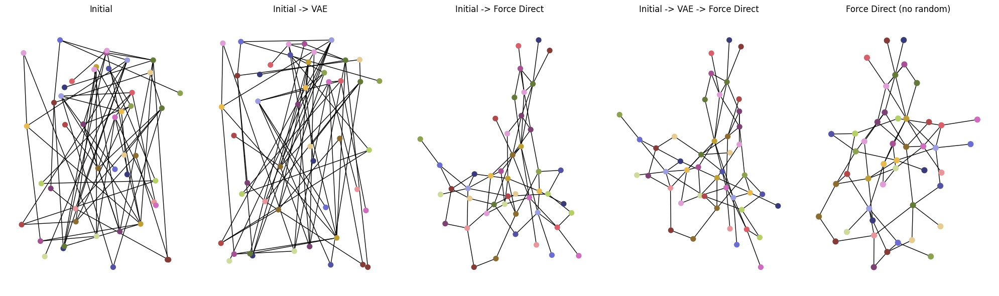

tensor(0.5916, grad_fn=<AddBackward0>)


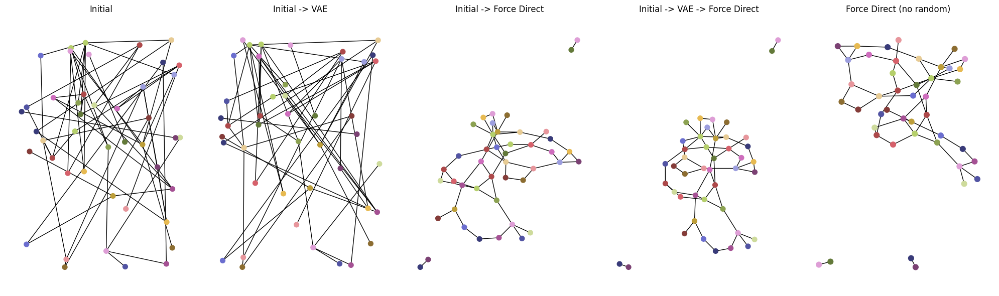

tensor(0.6896, grad_fn=<AddBackward0>)


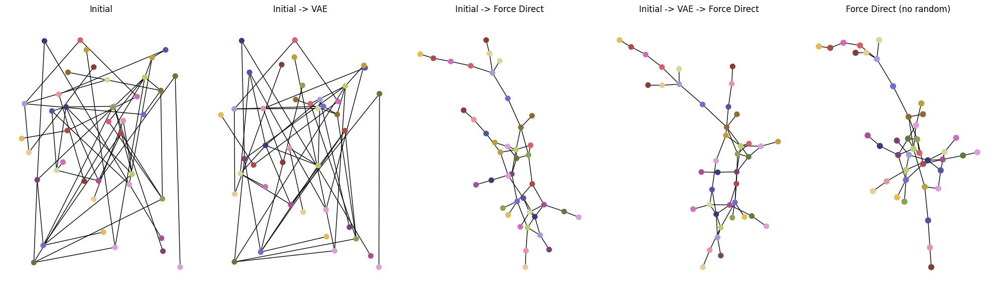

tensor(0.8307, grad_fn=<AddBackward0>)


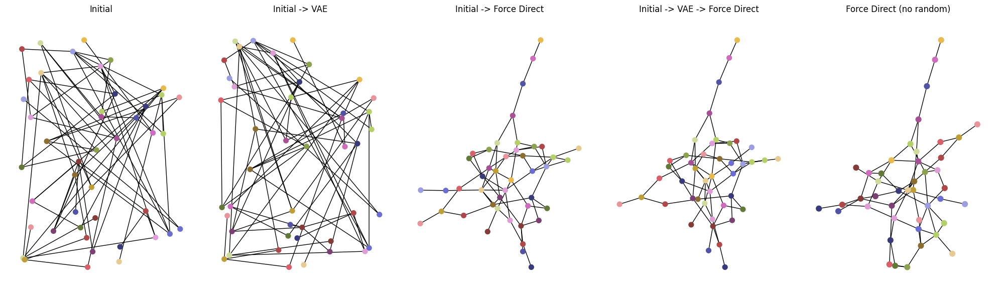

tensor(0.6031, grad_fn=<AddBackward0>)


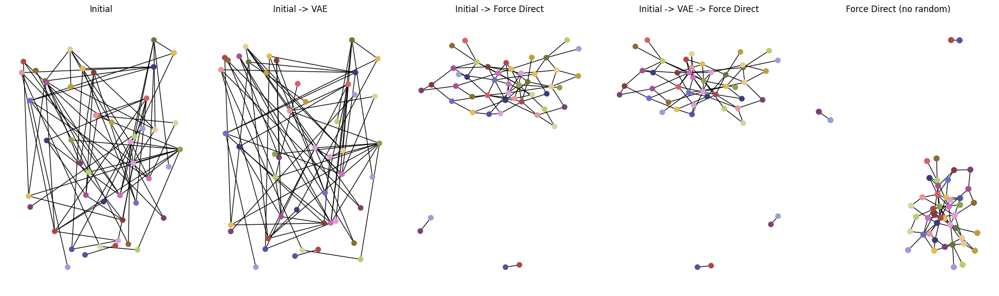

tensor(0.6669, grad_fn=<AddBackward0>)


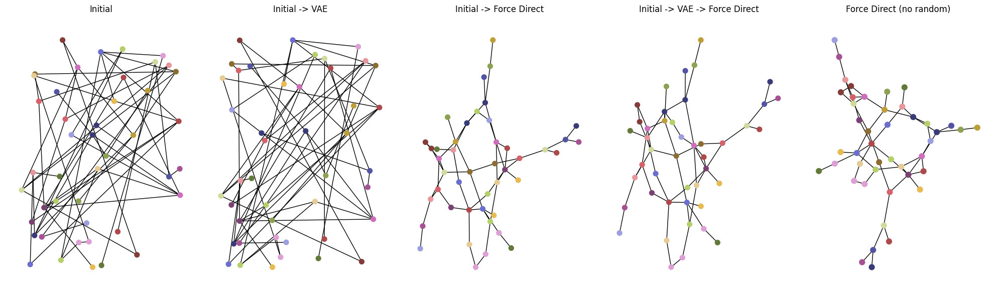

tensor(0.6722, grad_fn=<AddBackward0>)


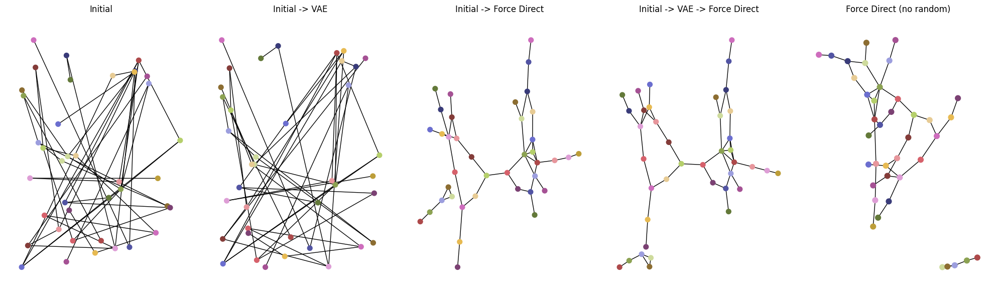

tensor(0.6986, grad_fn=<AddBackward0>)


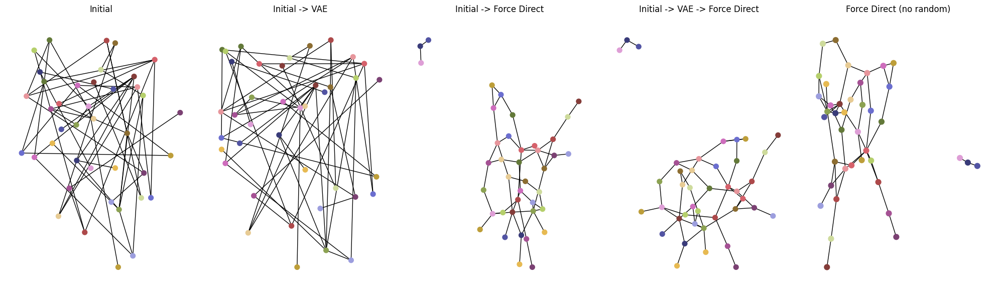

tensor(0.6503, grad_fn=<AddBackward0>)


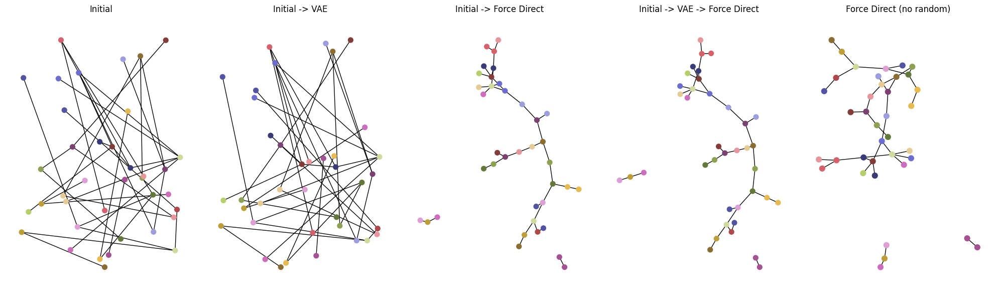

tensor(0.7522, grad_fn=<AddBackward0>)


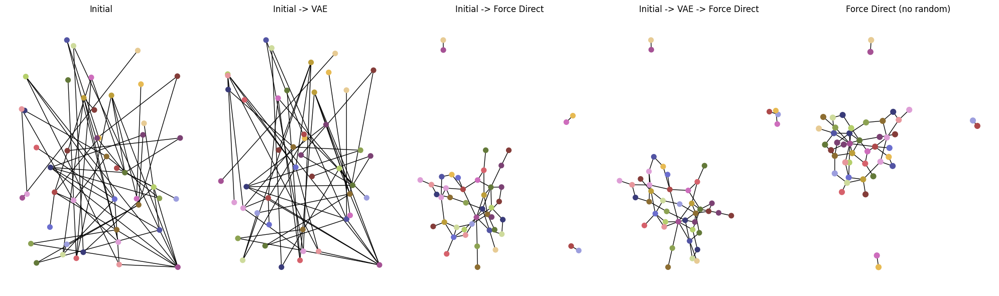

tensor(0.7775, grad_fn=<AddBackward0>)


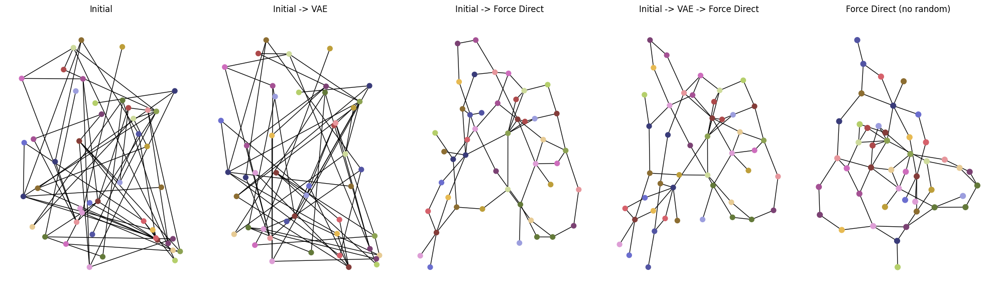

tensor(0.6041, grad_fn=<AddBackward0>)


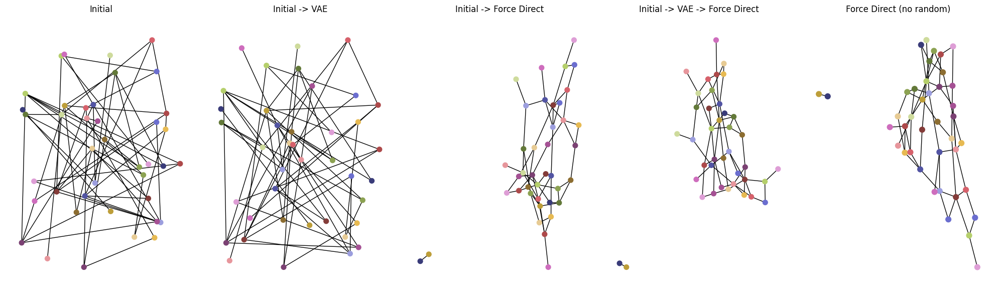

tensor(0.7806, grad_fn=<AddBackward0>)


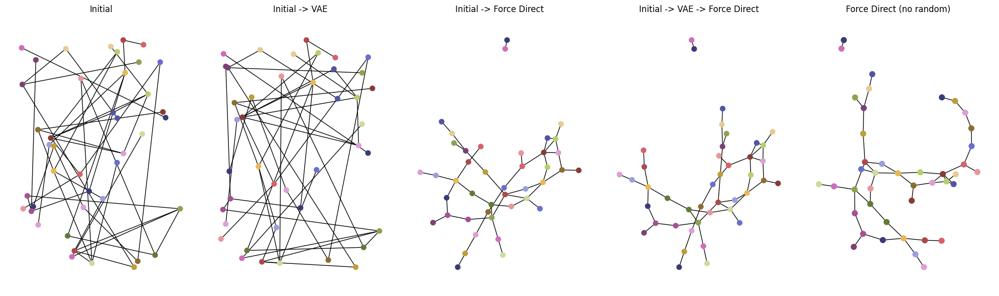

tensor(0.8862, grad_fn=<AddBackward0>)


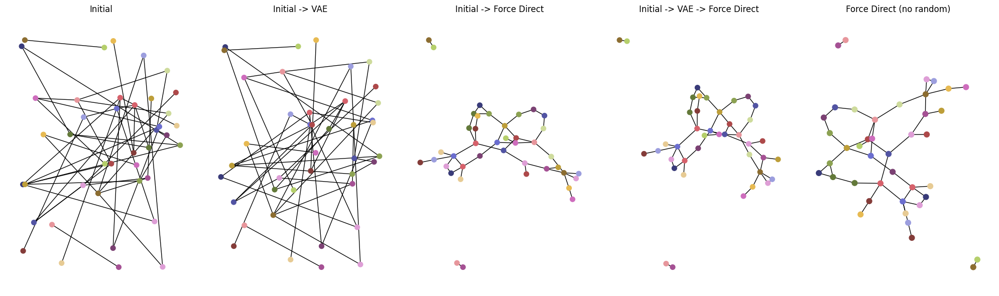

tensor(0.5668, grad_fn=<AddBackward0>)


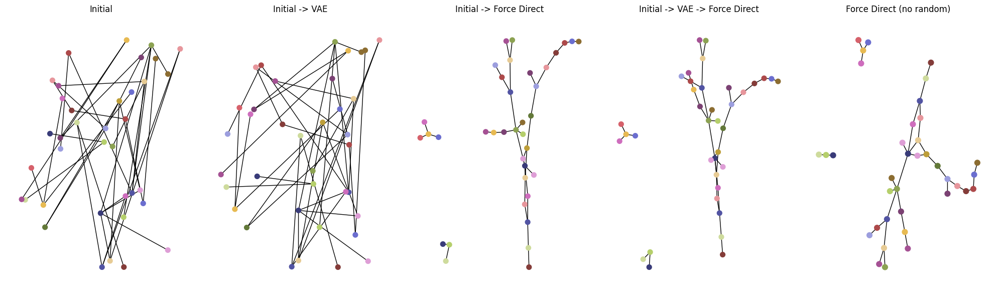

tensor(0.7125, grad_fn=<AddBackward0>)


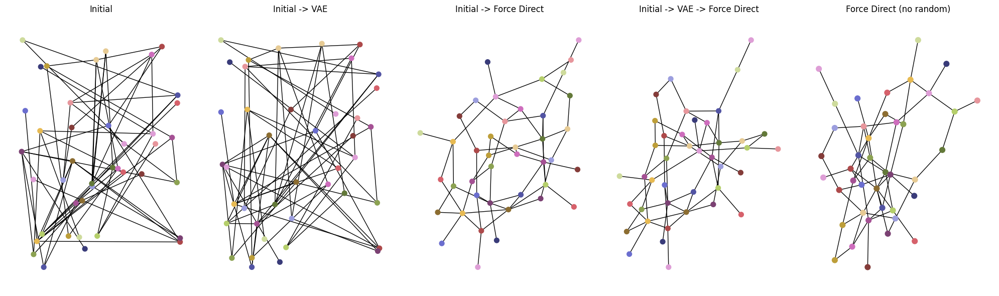

tensor(0.6047, grad_fn=<AddBackward0>)


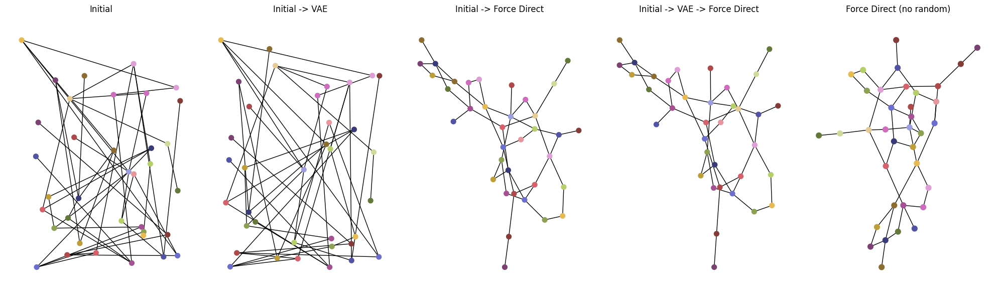

tensor(0.5938, grad_fn=<AddBackward0>)


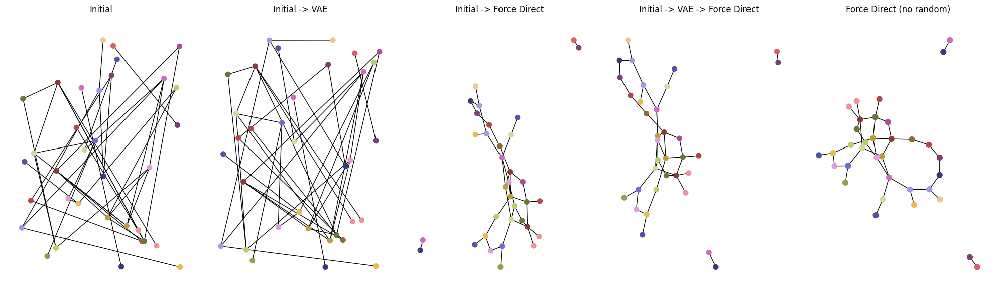

tensor(0.7154, grad_fn=<AddBackward0>)


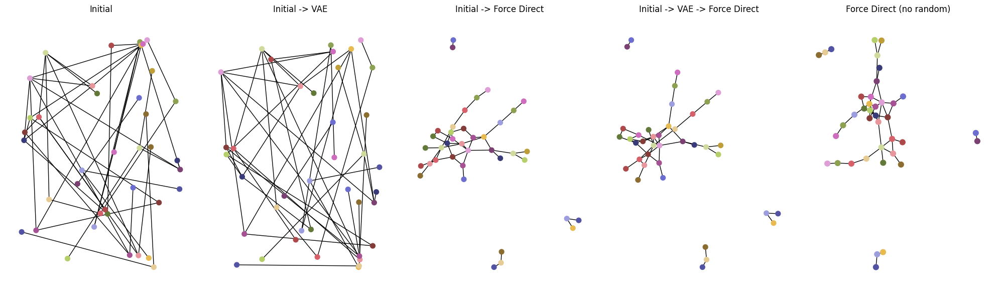

tensor(0.6357, grad_fn=<AddBackward0>)


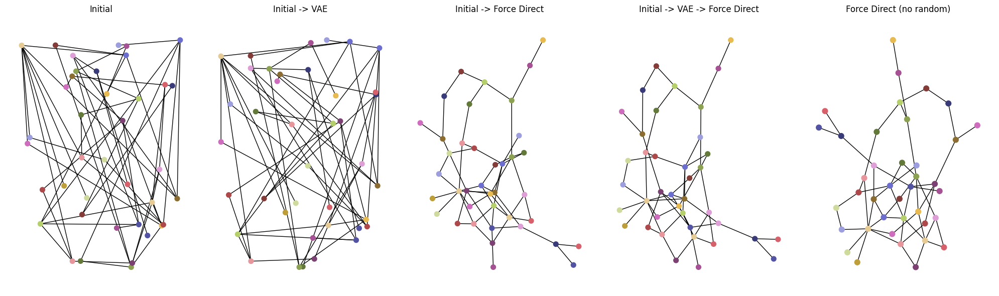

tensor(0.8751, grad_fn=<AddBackward0>)


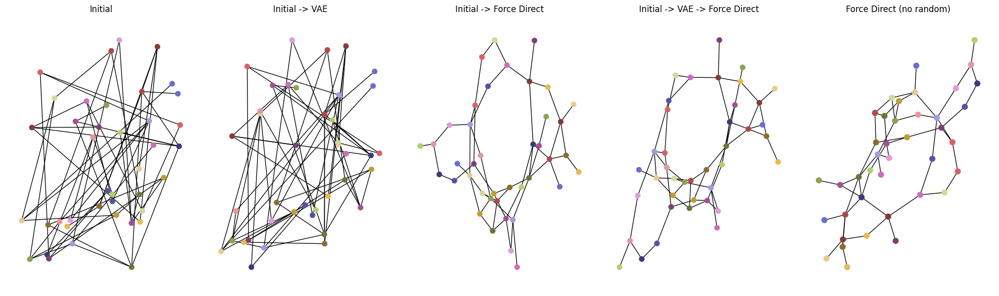

tensor(0.5789, grad_fn=<AddBackward0>)


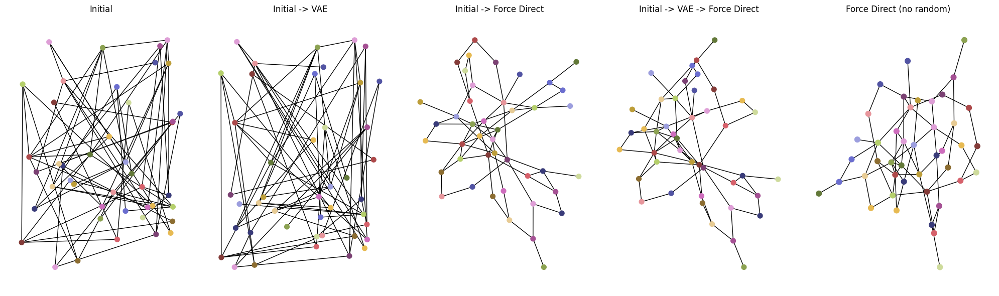

tensor(0.5840, grad_fn=<AddBackward0>)


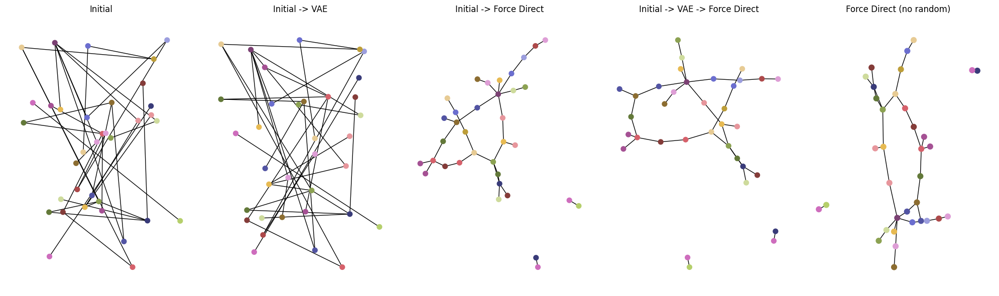

tensor(0.7697, grad_fn=<AddBackward0>)


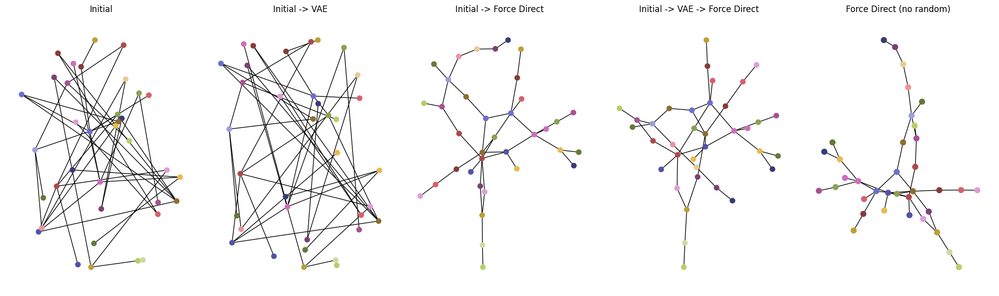

tensor(0.6683, grad_fn=<AddBackward0>)


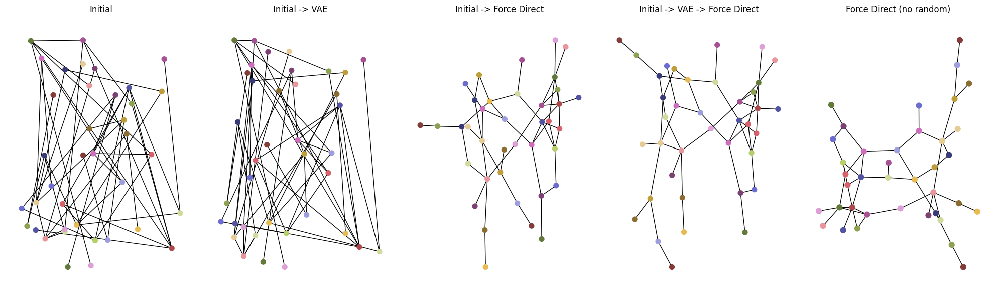

tensor(0.6802, grad_fn=<AddBackward0>)


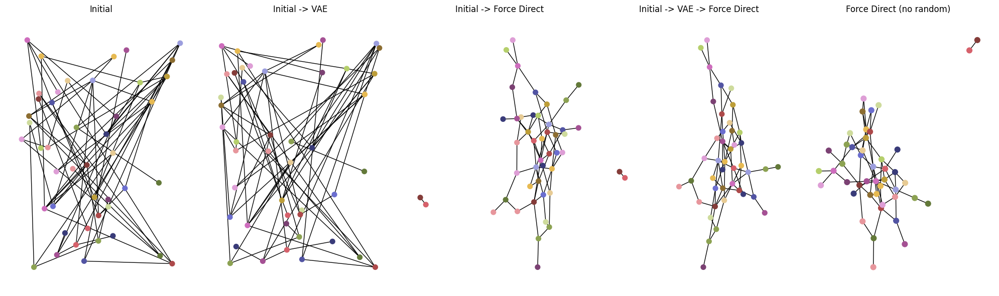

tensor(0.6001, grad_fn=<AddBackward0>)


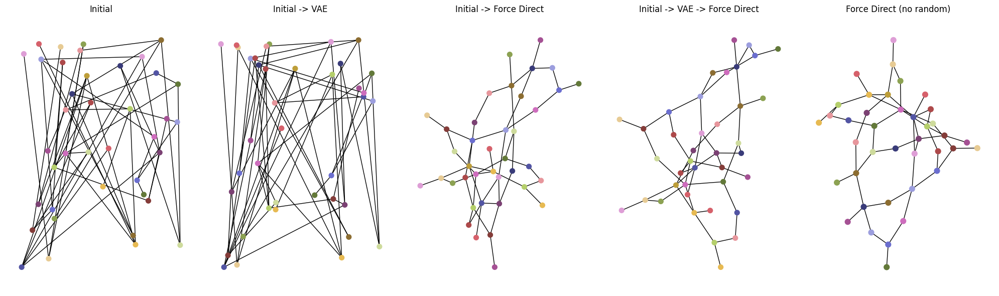

tensor(0.6601, grad_fn=<AddBackward0>)


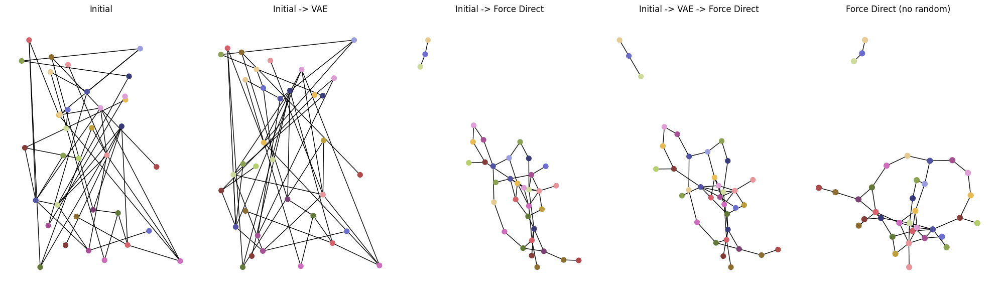

tensor(0.6594, grad_fn=<AddBackward0>)


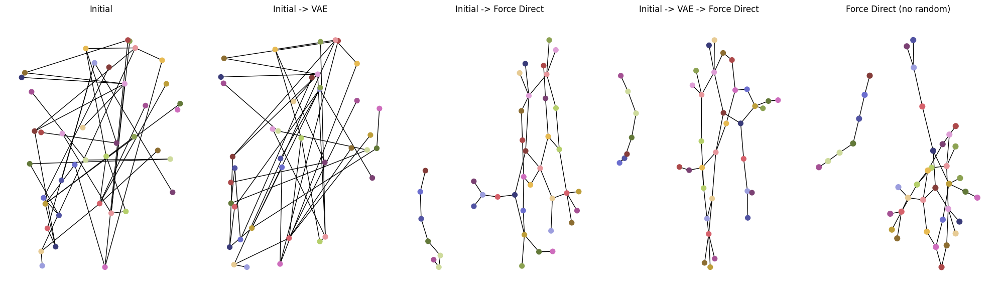

tensor(0.6166, grad_fn=<AddBackward0>)


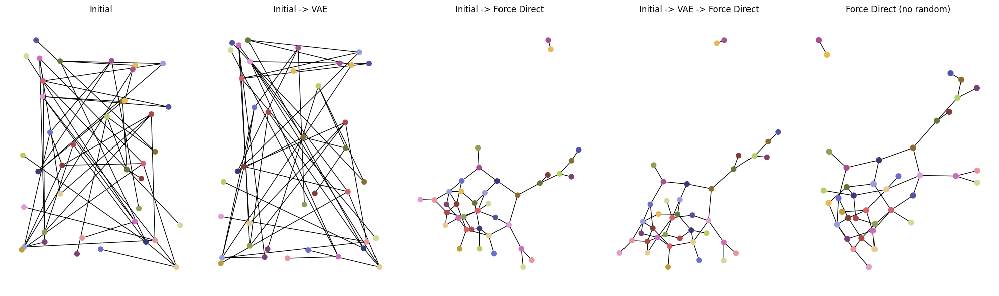

tensor(0.6751, grad_fn=<AddBackward0>)


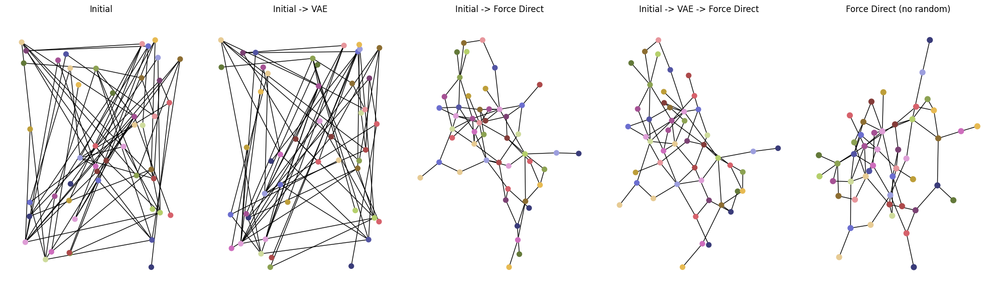

tensor(0.6602, grad_fn=<AddBackward0>)


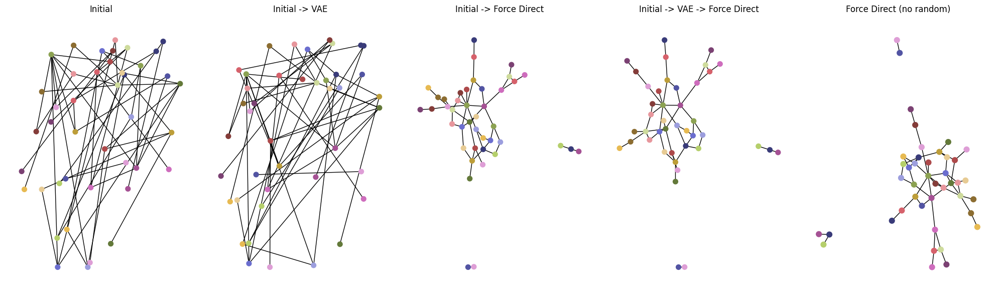

tensor(0.4824, grad_fn=<AddBackward0>)


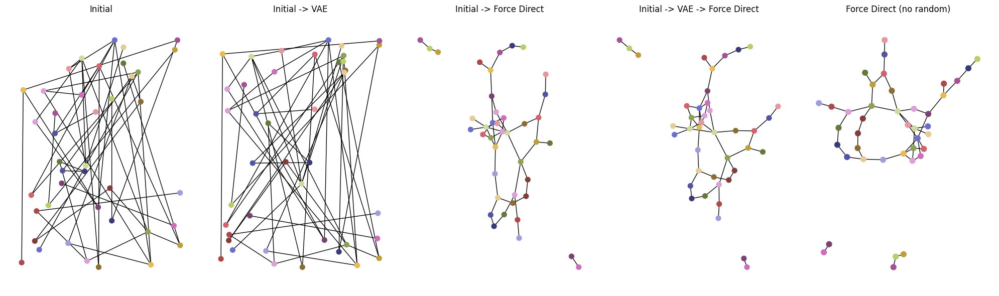

tensor(0.7382, grad_fn=<AddBackward0>)


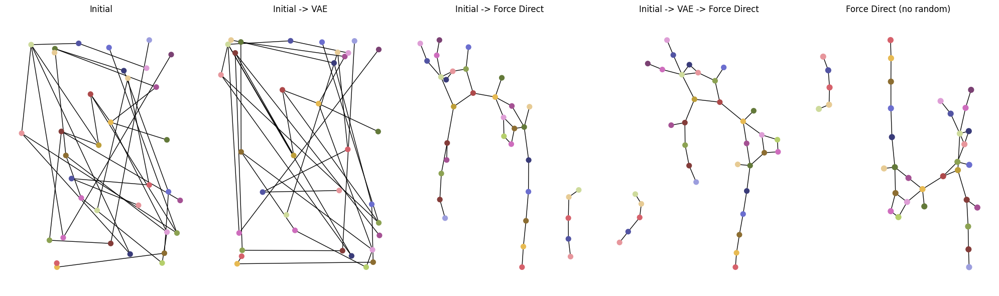

tensor(0.5956, grad_fn=<AddBackward0>)


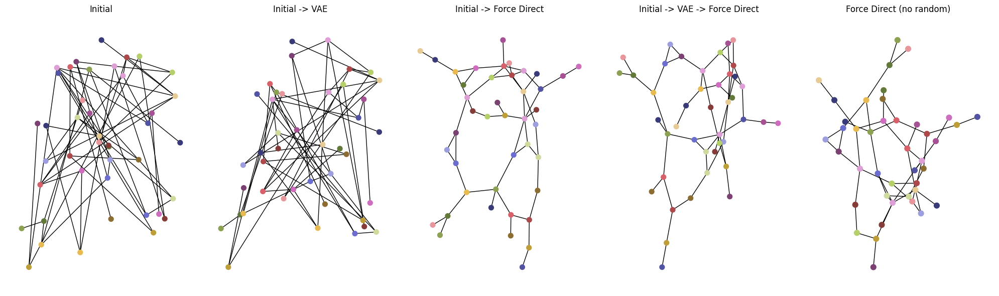

tensor(0.6566, grad_fn=<AddBackward0>)


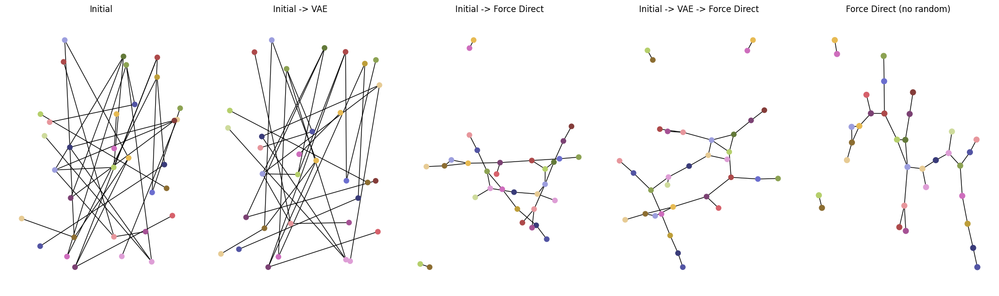

tensor(0.9663, grad_fn=<AddBackward0>)


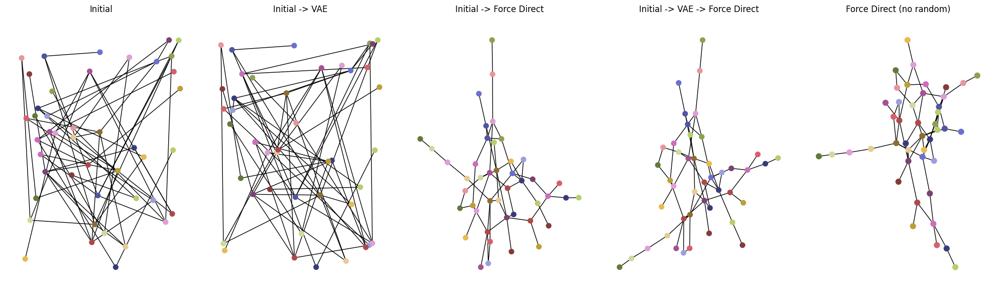

tensor(0.5734, grad_fn=<AddBackward0>)


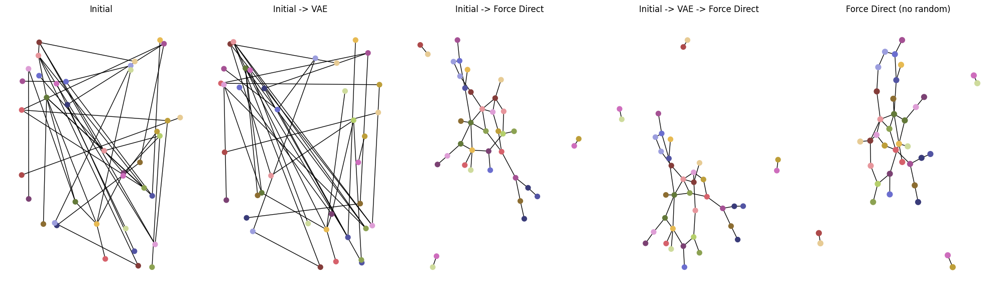

tensor(0.8010, grad_fn=<AddBackward0>)


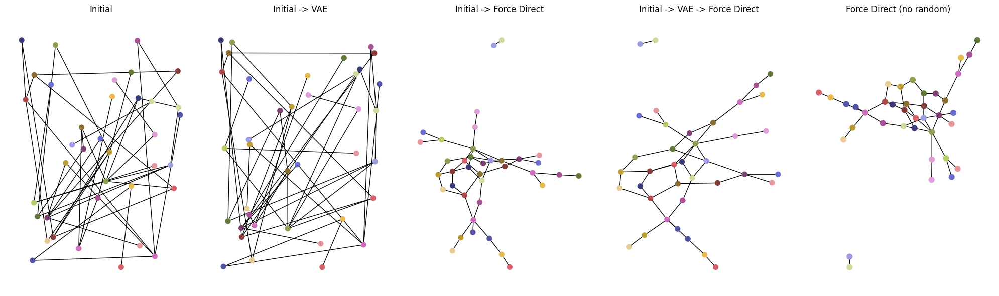

tensor(0.6440, grad_fn=<AddBackward0>)


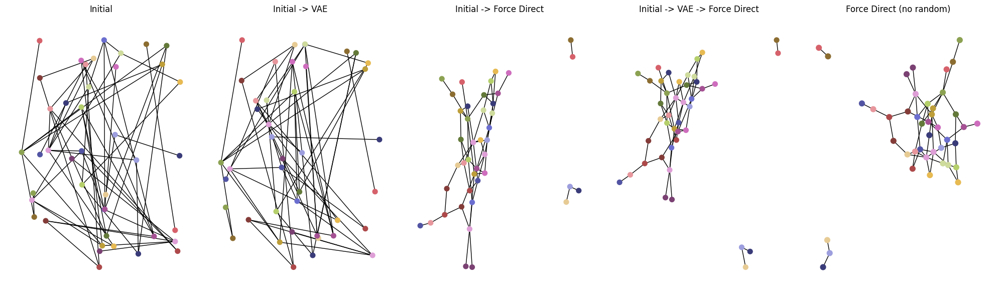

tensor(0.6934, grad_fn=<AddBackward0>)


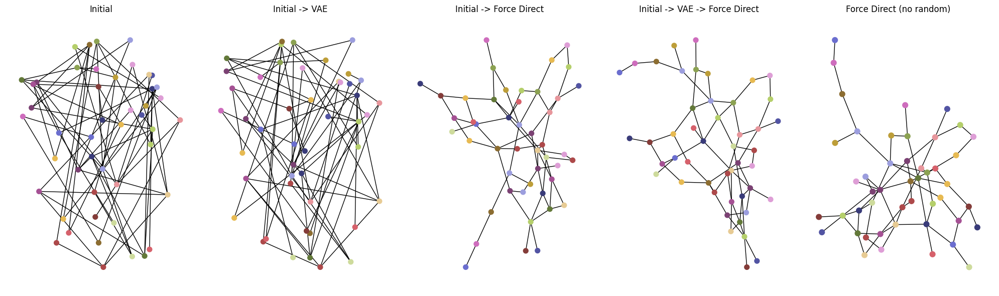

tensor(0.6231, grad_fn=<AddBackward0>)


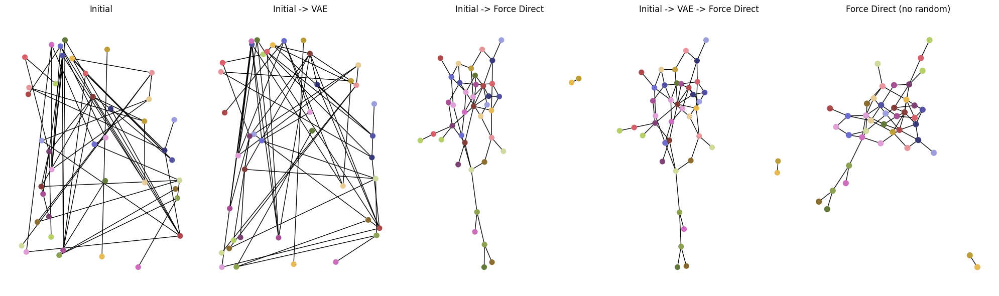

tensor(0.8505, grad_fn=<AddBackward0>)


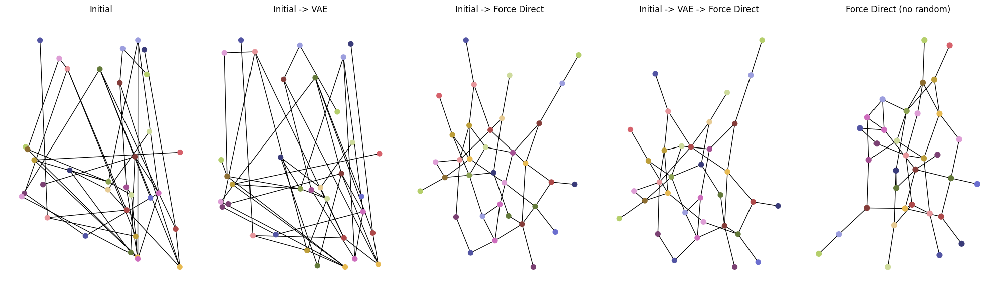

tensor(0.4755, grad_fn=<AddBackward0>)


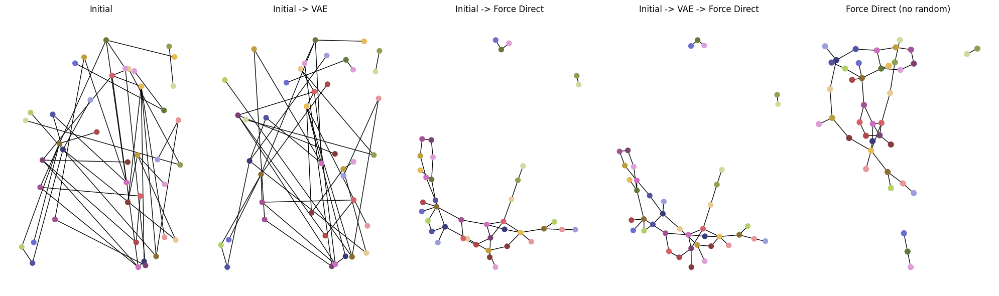

tensor(0.8410, grad_fn=<AddBackward0>)


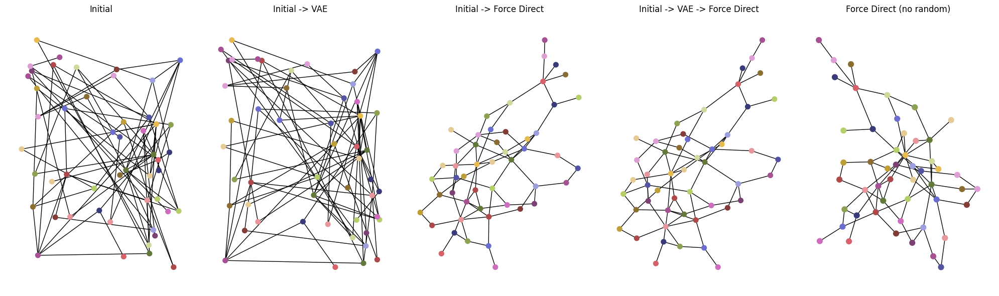

tensor(0.6029, grad_fn=<AddBackward0>)


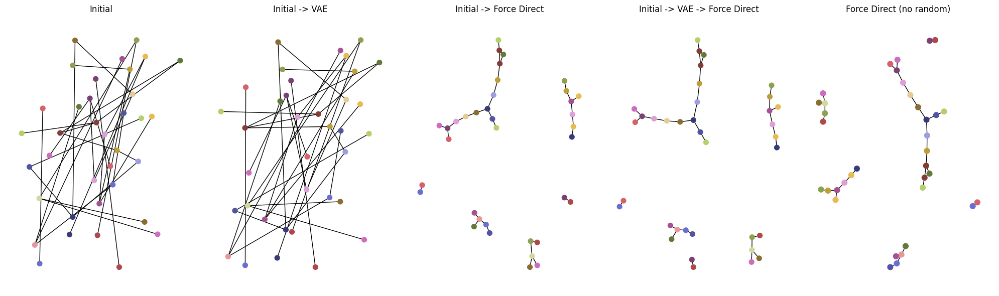

tensor(0.5335, grad_fn=<AddBackward0>)


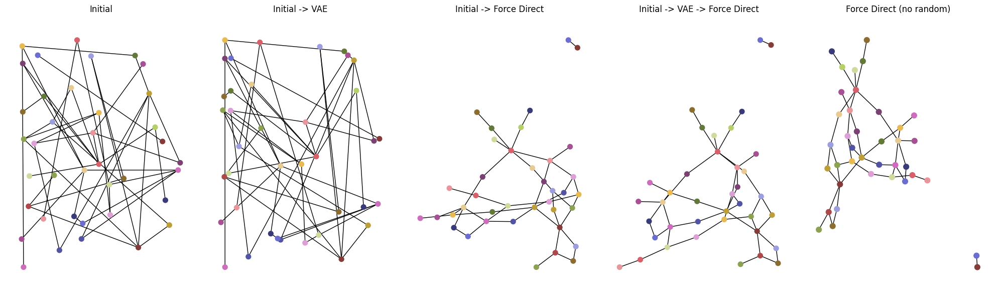

tensor(0.7451, grad_fn=<AddBackward0>)


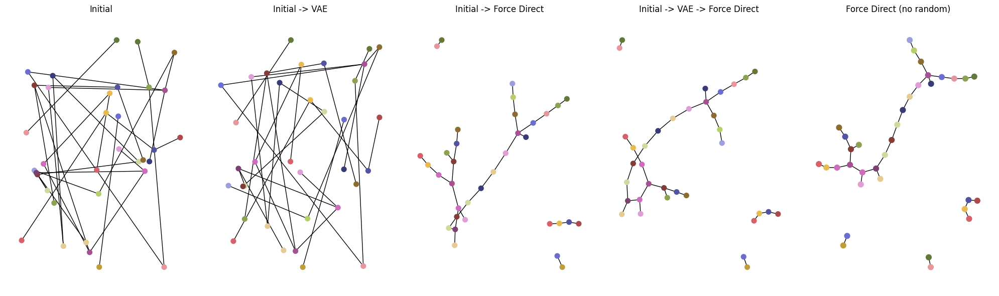

tensor(0.7511, grad_fn=<AddBackward0>)


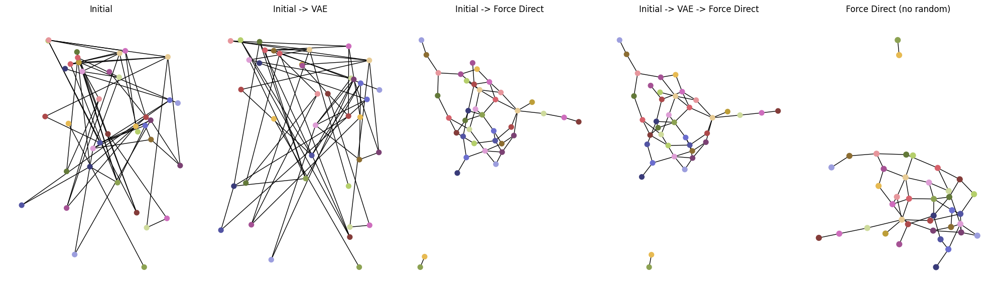

tensor(0.7839, grad_fn=<AddBackward0>)


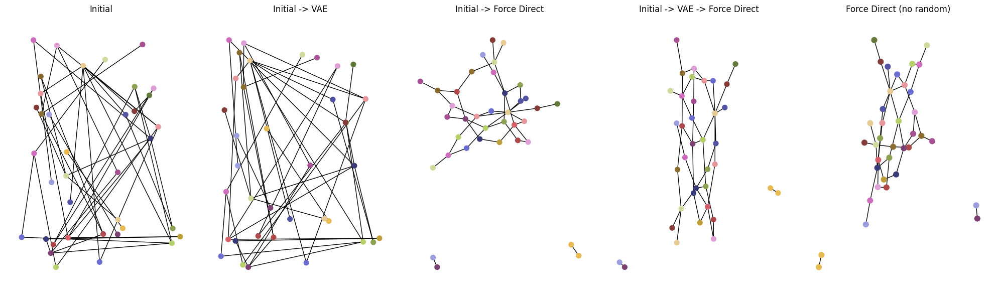

tensor(0.7812, grad_fn=<AddBackward0>)


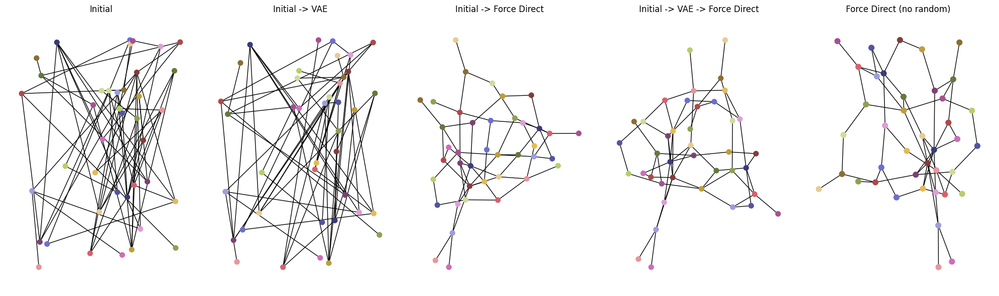

tensor(0.6189, grad_fn=<AddBackward0>)


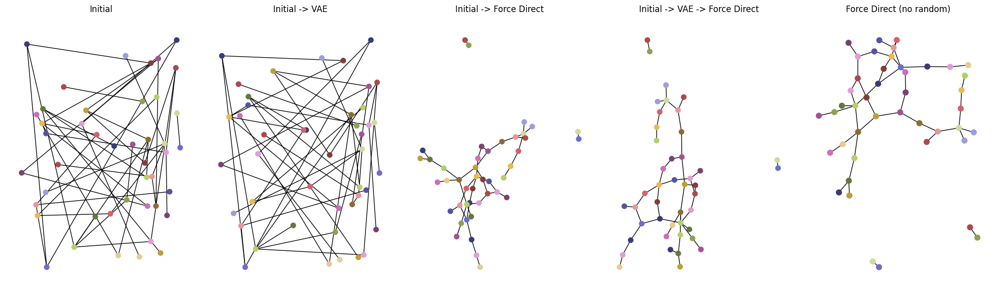

tensor(0.6228, grad_fn=<AddBackward0>)


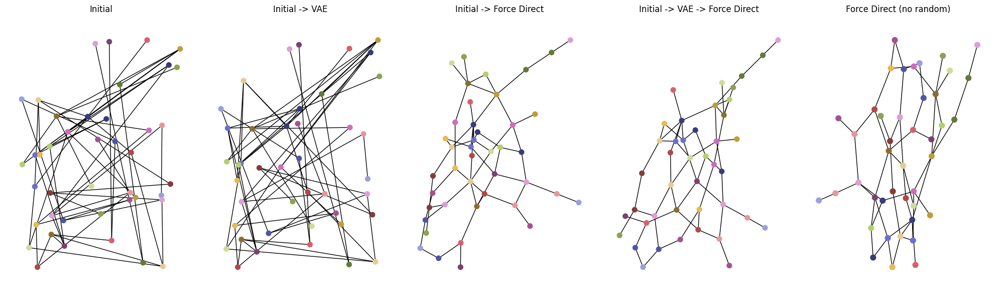

tensor(0.6270, grad_fn=<AddBackward0>)


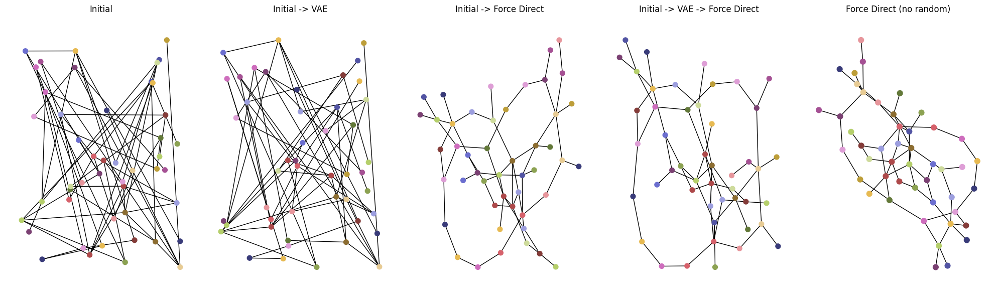

tensor(0.9258, grad_fn=<AddBackward0>)


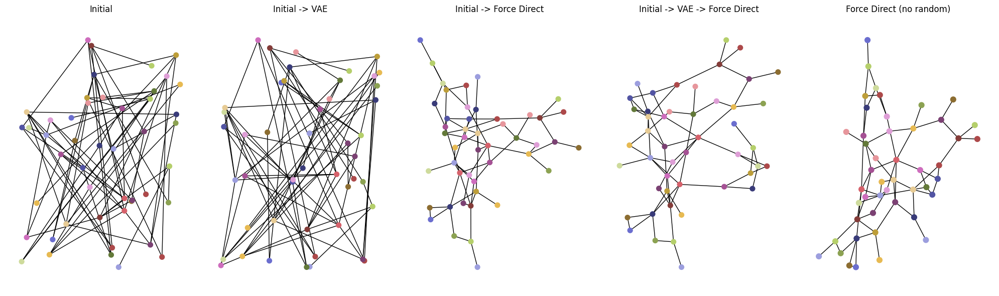

tensor(0.6556, grad_fn=<AddBackward0>)


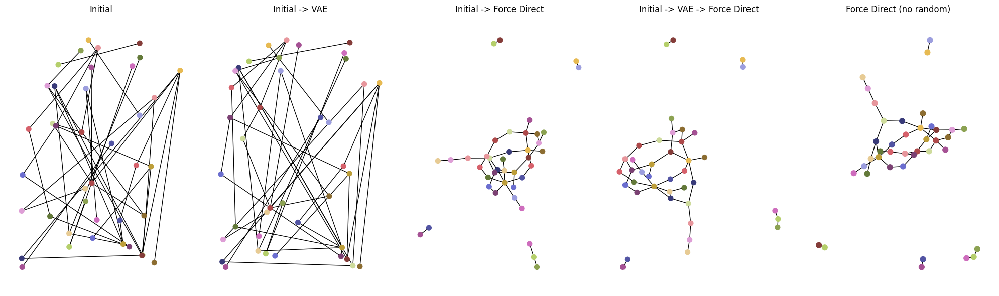

tensor(0.4276, grad_fn=<AddBackward0>)


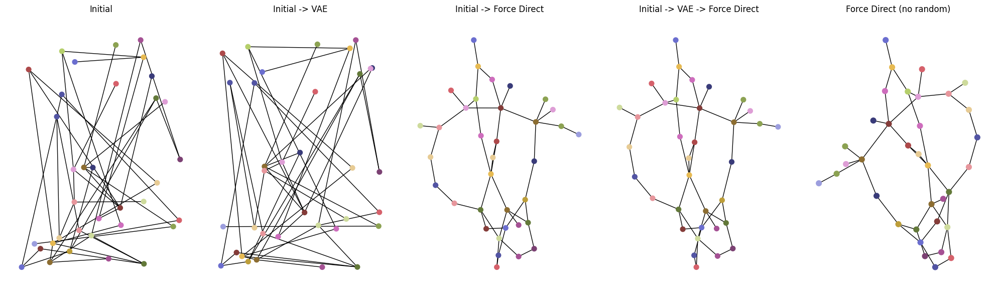

tensor(0.8108, grad_fn=<AddBackward0>)


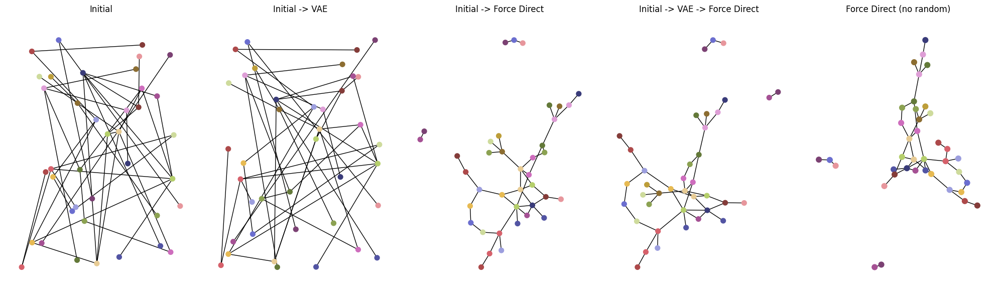

tensor(0.7054, grad_fn=<AddBackward0>)


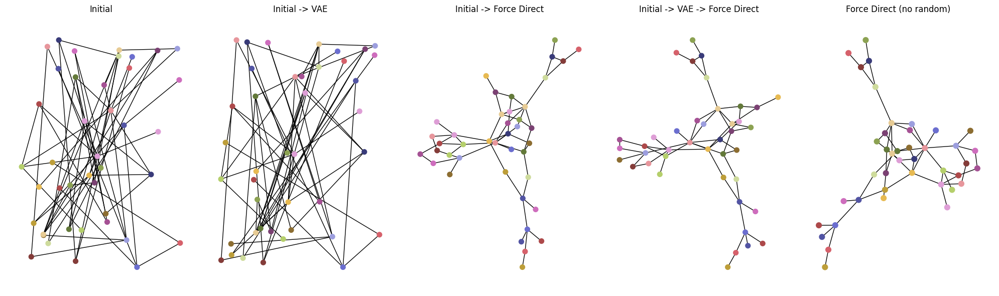

tensor(0.7510, grad_fn=<AddBackward0>)


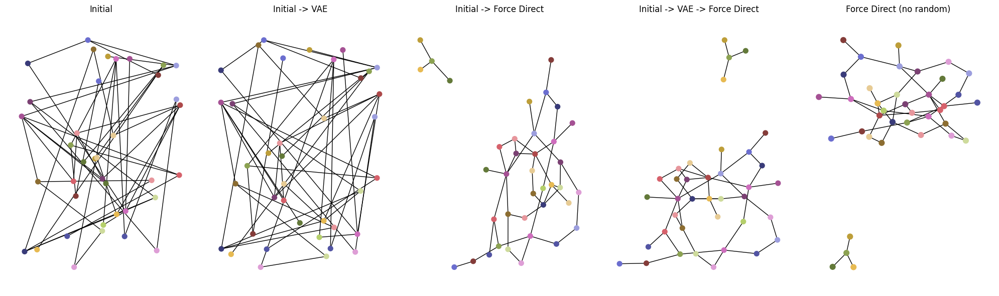

tensor(0.8832, grad_fn=<AddBackward0>)


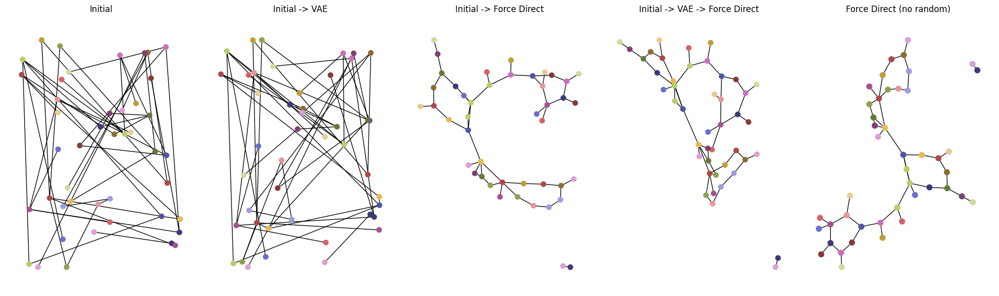

tensor(0.6463, grad_fn=<AddBackward0>)


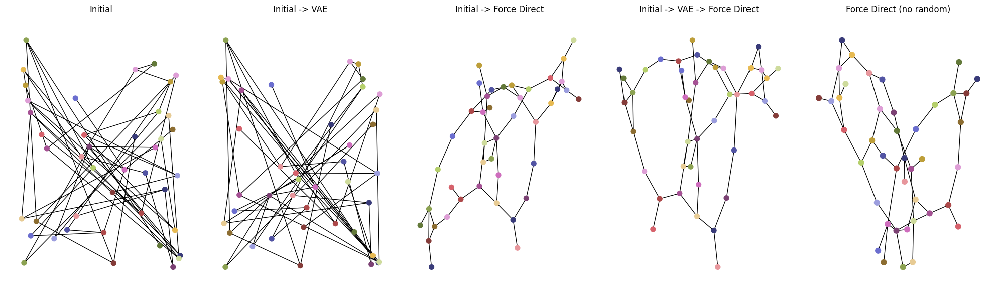

tensor(0.6643, grad_fn=<AddBackward0>)


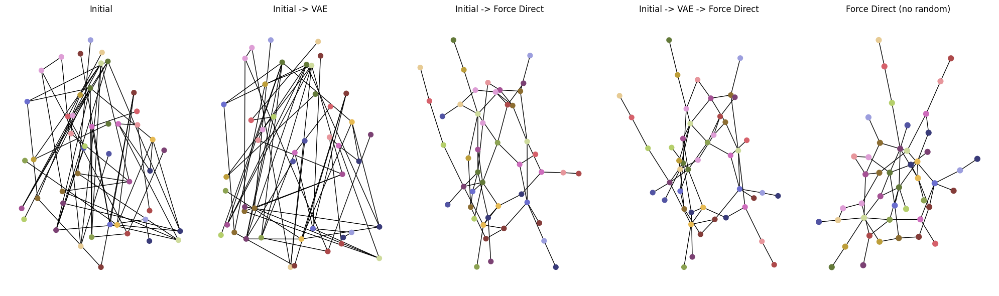

tensor(0.5409, grad_fn=<AddBackward0>)


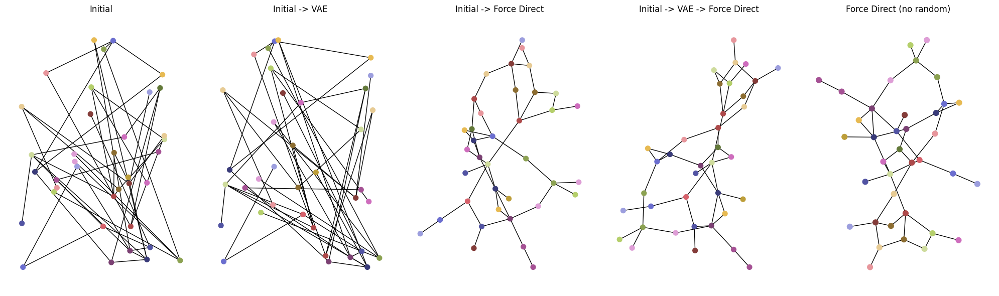

tensor(0.6974, grad_fn=<AddBackward0>)


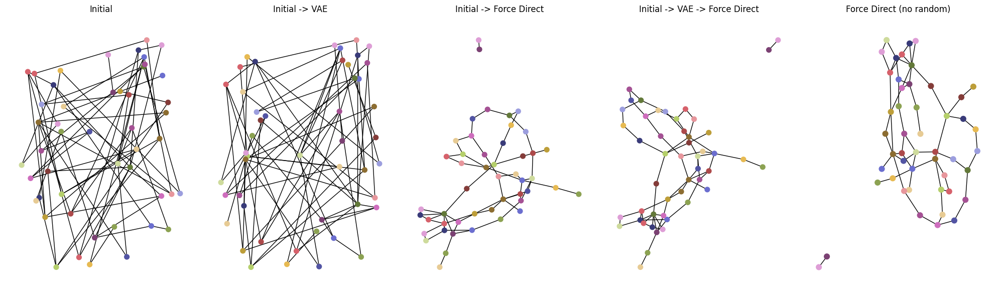

tensor(0.8017, grad_fn=<AddBackward0>)


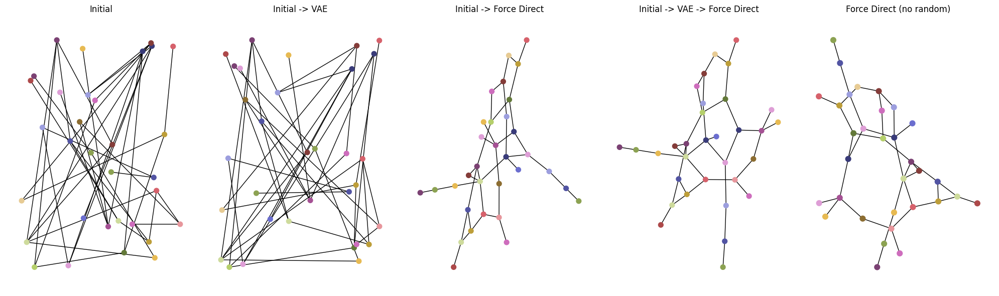

tensor(0.4983, grad_fn=<AddBackward0>)


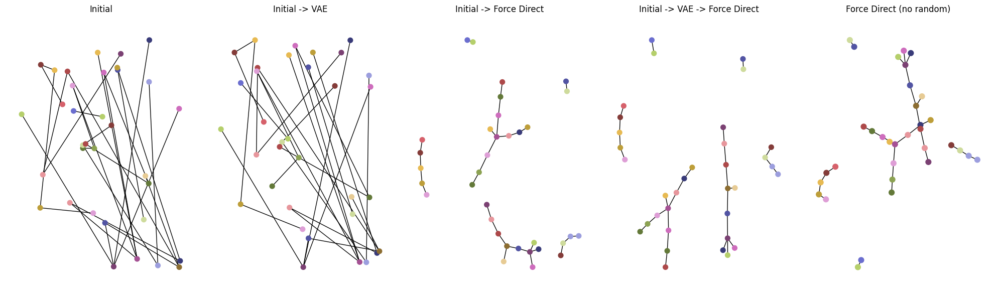

tensor(0.7908, grad_fn=<AddBackward0>)


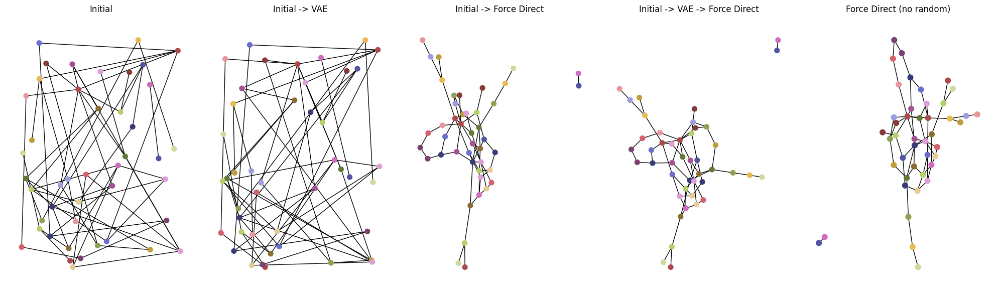

tensor(0.5713, grad_fn=<AddBackward0>)


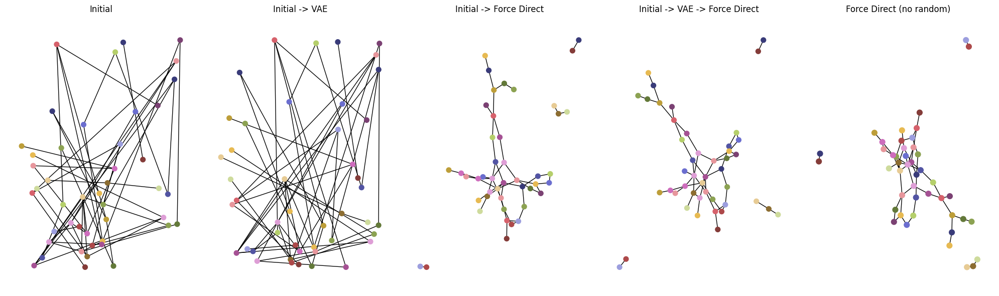

tensor(0.5863, grad_fn=<AddBackward0>)


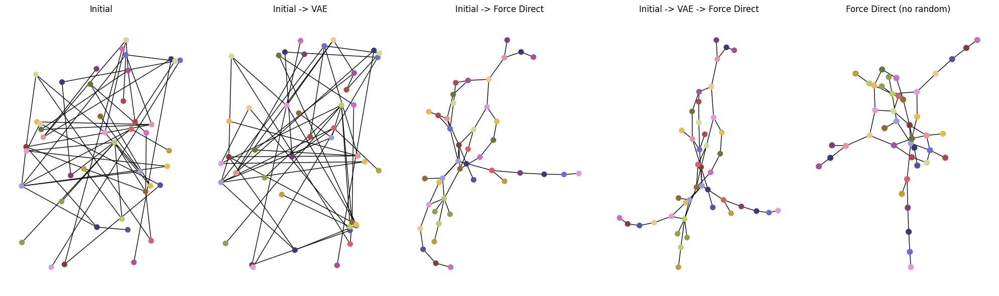

tensor(0.5348, grad_fn=<AddBackward0>)


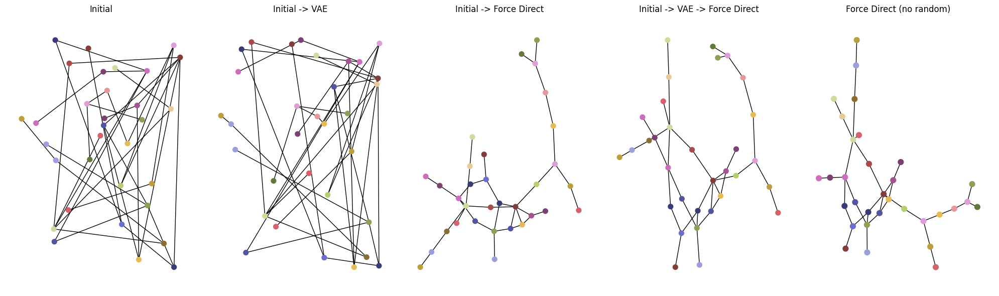

tensor(0.6812, grad_fn=<AddBackward0>)


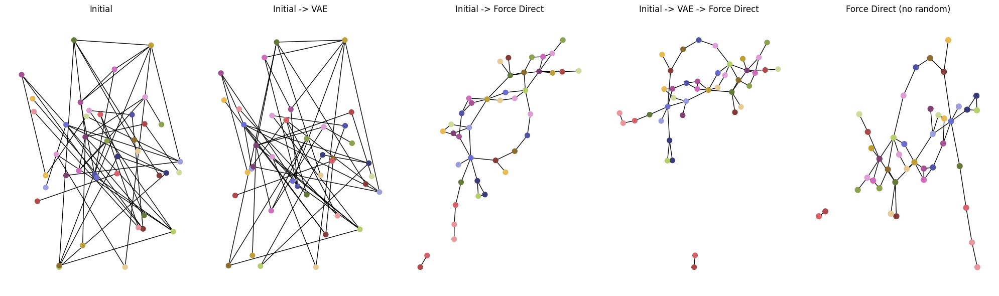

tensor(0.7311, grad_fn=<AddBackward0>)


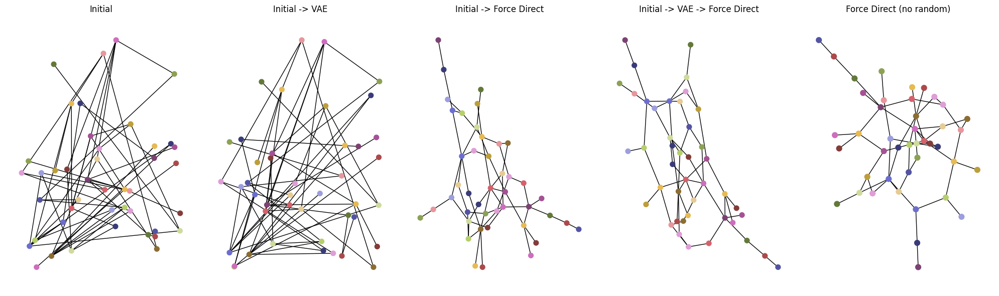

tensor(0.7635, grad_fn=<AddBackward0>)


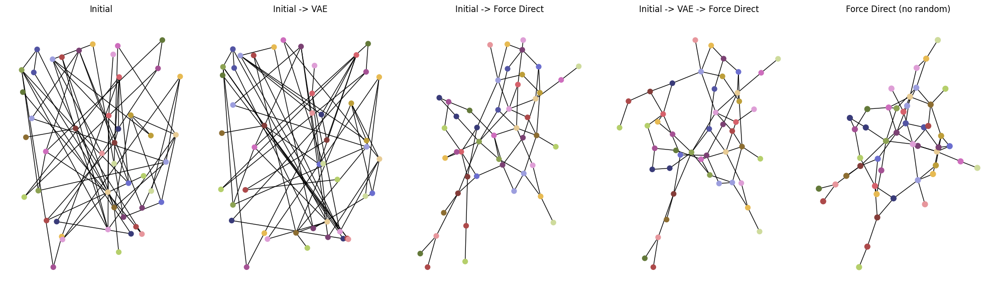

tensor(0.7414, grad_fn=<AddBackward0>)


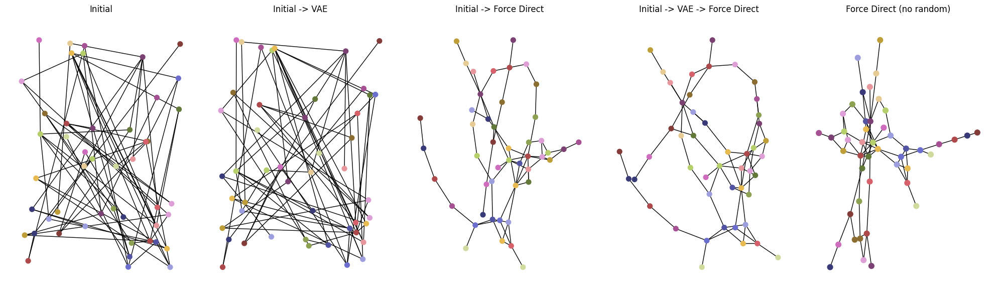

tensor(0.7817, grad_fn=<AddBackward0>)


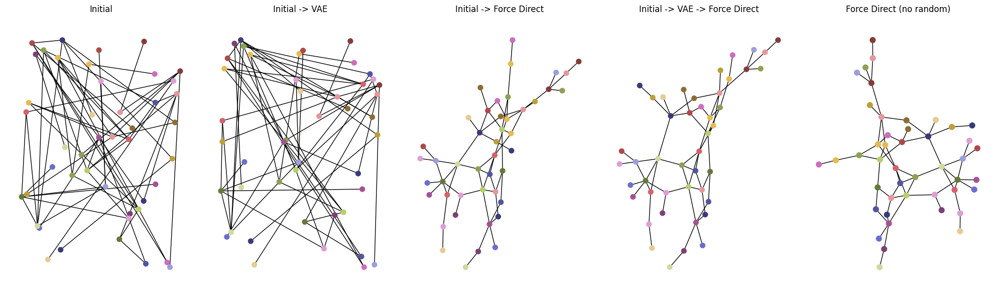

tensor(0.4020, grad_fn=<AddBackward0>)


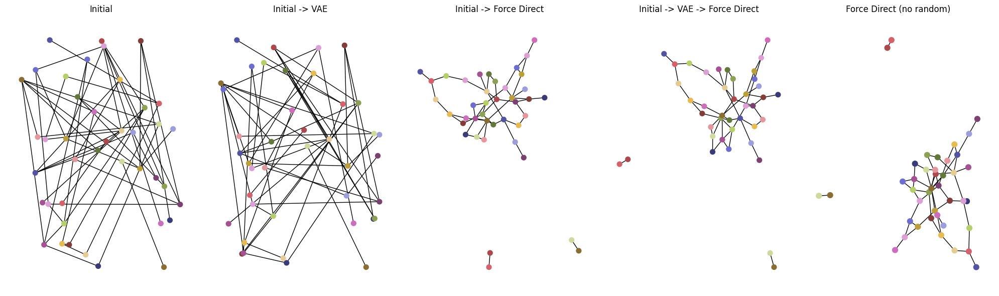

tensor(0.7499, grad_fn=<AddBackward0>)


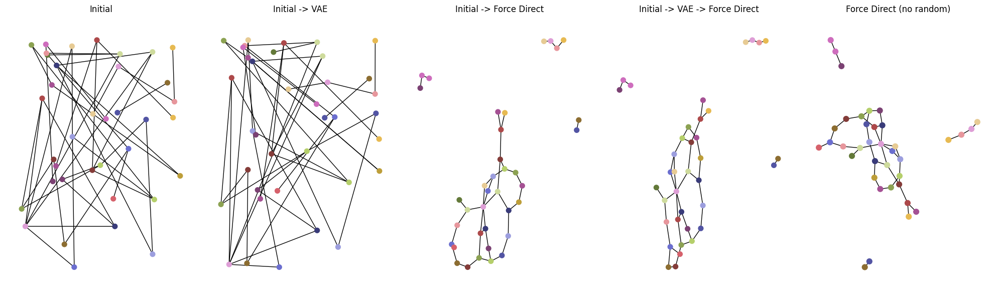

tensor(0.6977, grad_fn=<AddBackward0>)


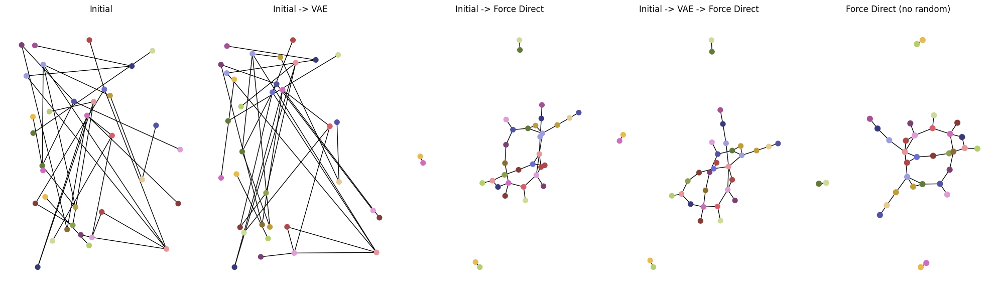

tensor(0.8701, grad_fn=<AddBackward0>)


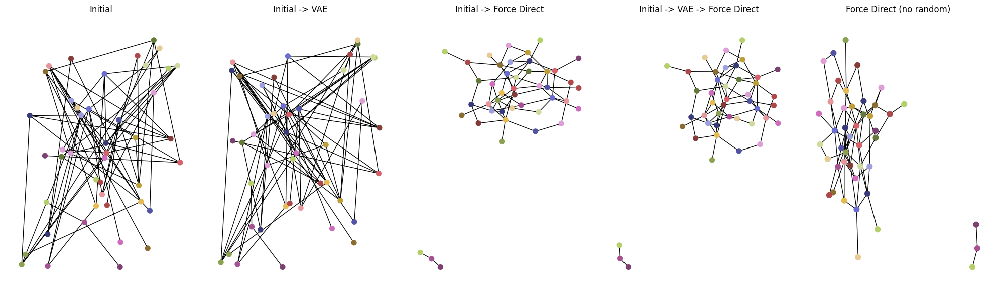

tensor(0.6366, grad_fn=<AddBackward0>)


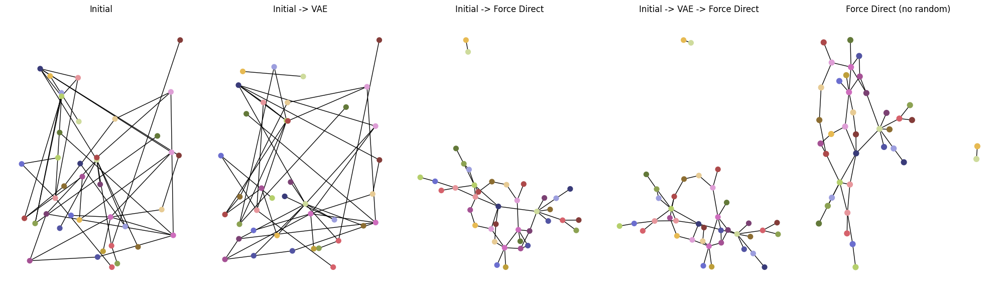

tensor(0.5267, grad_fn=<AddBackward0>)


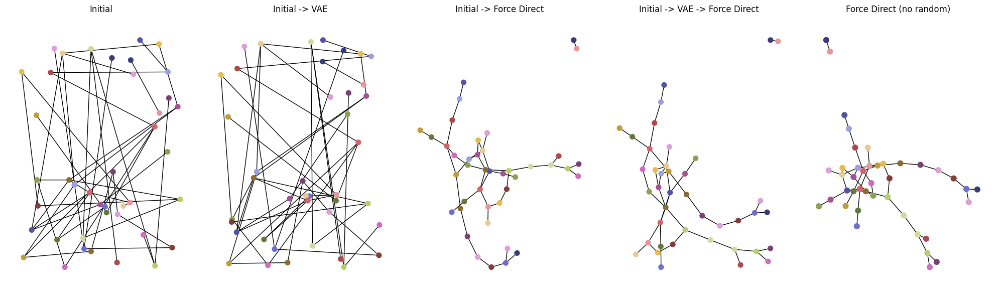

tensor(0.6159, grad_fn=<AddBackward0>)


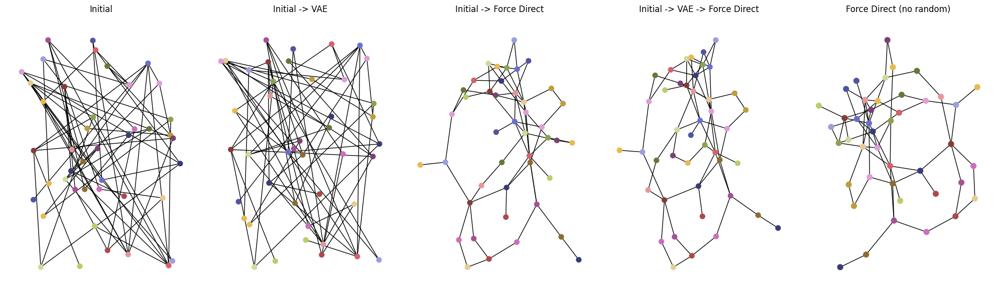

tensor(0.4430, grad_fn=<AddBackward0>)


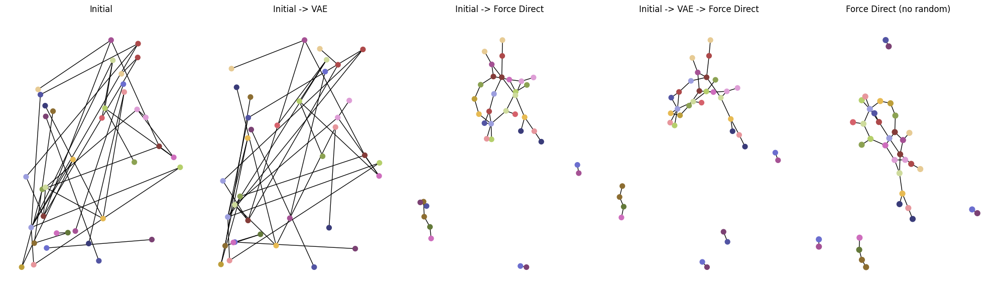

tensor(0.8950, grad_fn=<AddBackward0>)


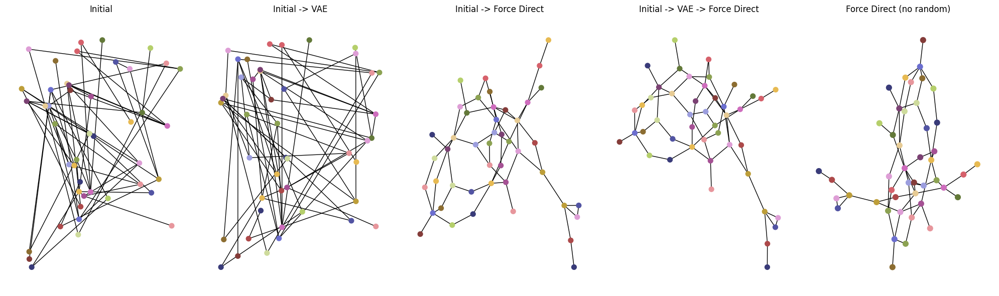

tensor(0.5010, grad_fn=<AddBackward0>)


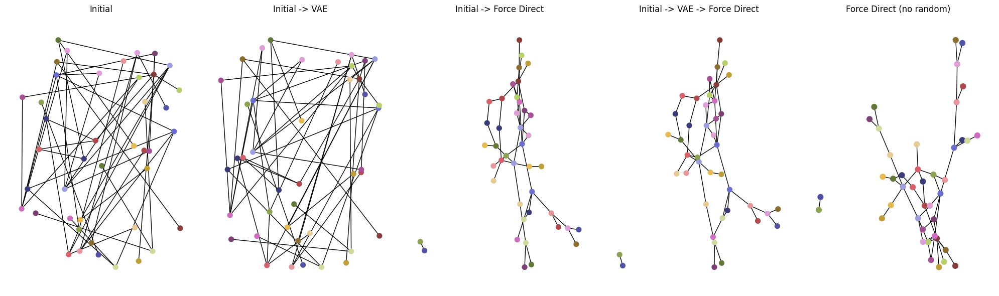

tensor(0.6328, grad_fn=<AddBackward0>)


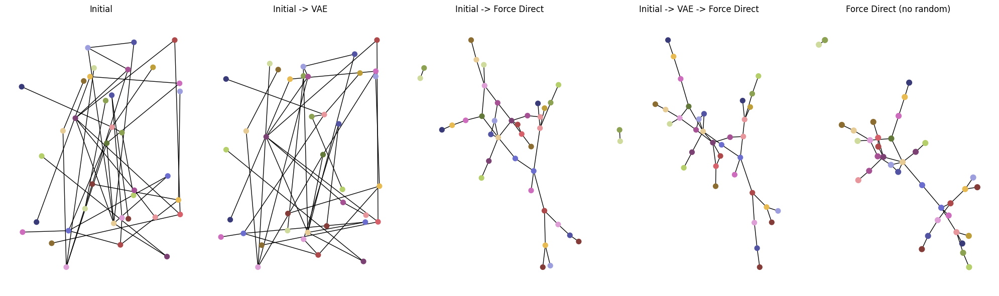

tensor(0.7266, grad_fn=<AddBackward0>)


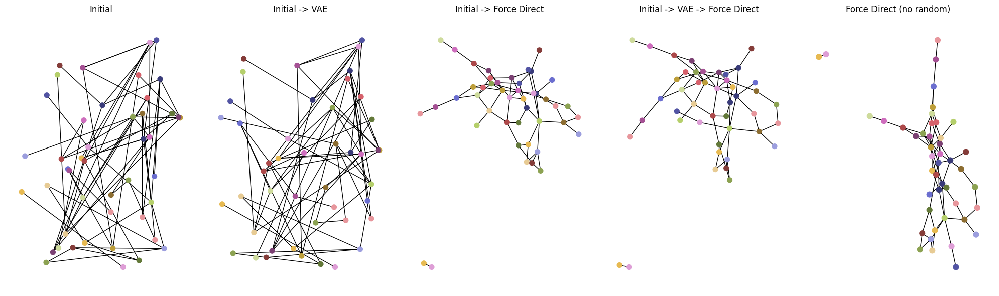

tensor(0.6947, grad_fn=<AddBackward0>)


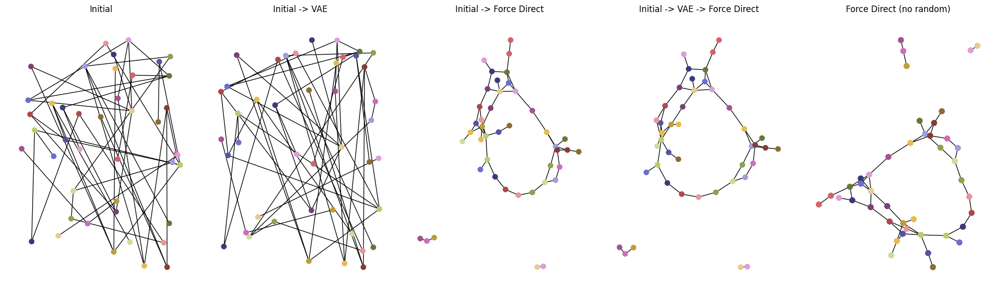

tensor(0.6993, grad_fn=<AddBackward0>)


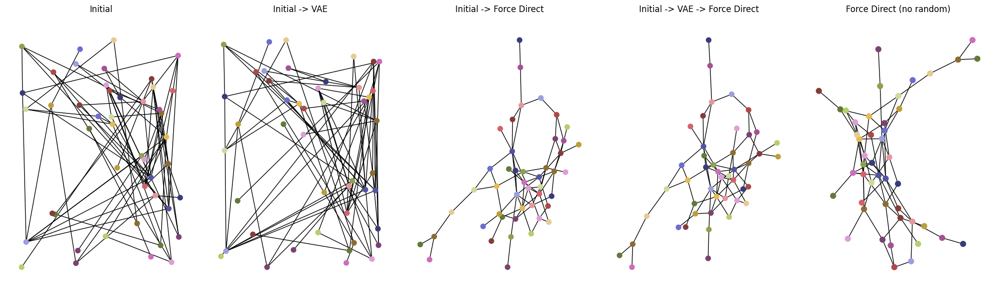

tensor(0.7456, grad_fn=<AddBackward0>)


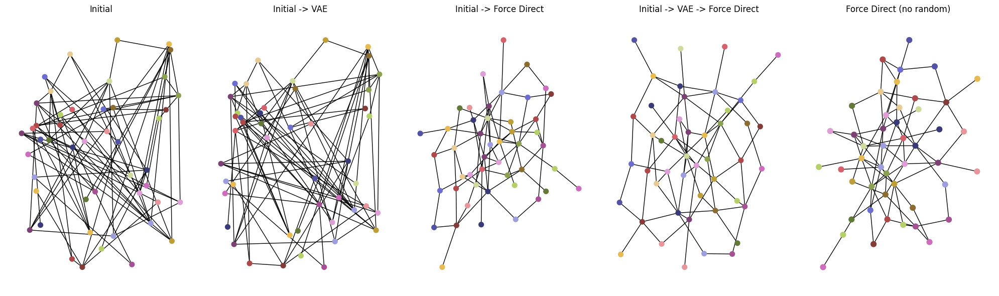

tensor(0.5355, grad_fn=<AddBackward0>)


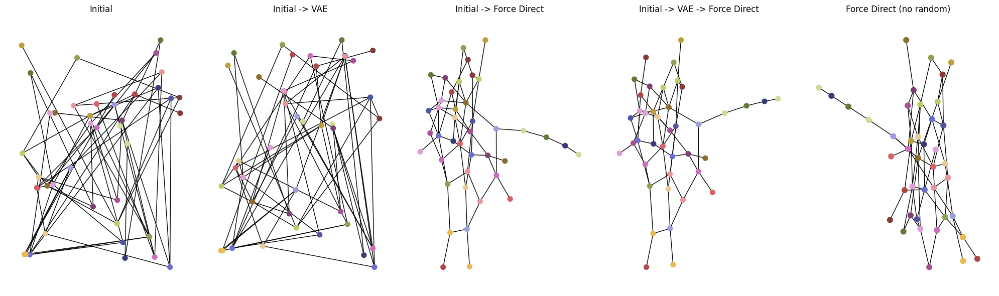

tensor(0.5107, grad_fn=<AddBackward0>)


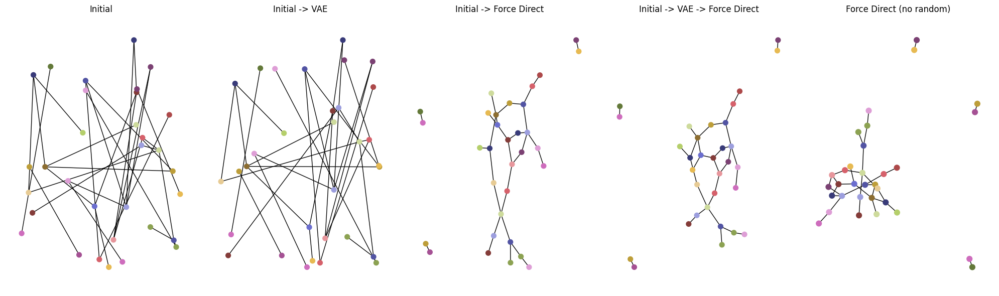

tensor(0.6582, grad_fn=<AddBackward0>)


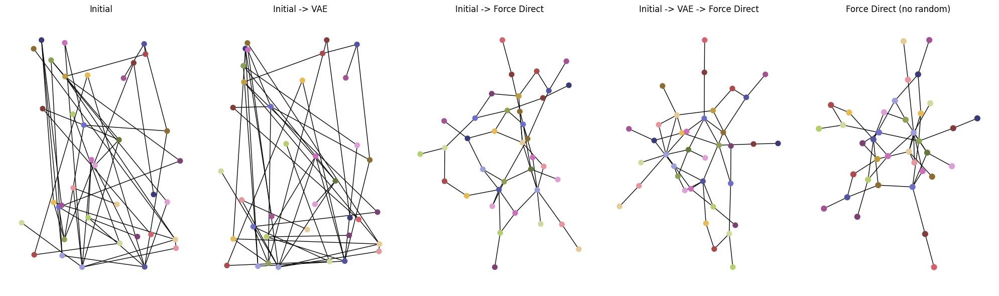

tensor(0.6301, grad_fn=<AddBackward0>)


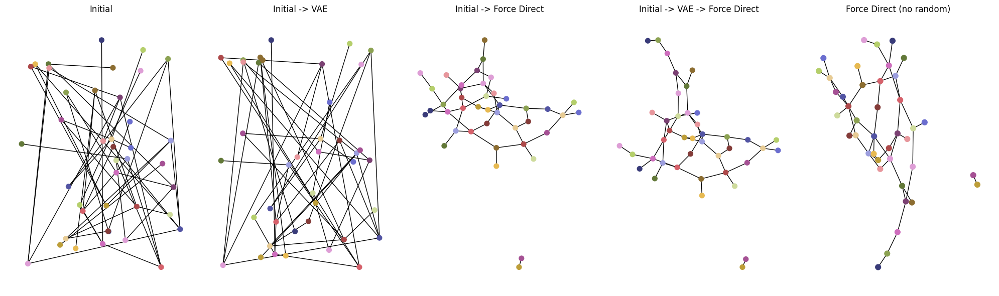

In [12]:
scores_model = []
scores_force = []
scores_force_only = []
graphs = []
model_pos = []
force_pos = []
force_o_pos = []

hidden_dim = 1024
latent_dim = 30
num_instances = 100
for i in range (num_instances):
    num_nodes = random.randint (40, 50) #Initializing number of nodes
    p = 0.05
    G = gen_graphs(num_nodes, p)

    graphs.append (G)
    #Updating number of nodes as number of connected nodes
    num_nodes = len (list(G))
    
    initial_pos = torch.tensor (np.random.rand(num_nodes, 2), dtype = torch.float )
    edges = np.array(G.edges)
    
    data = initial_pos.view(1, -1)
    
    input_dim = num_nodes * 2
    
    model = VAE (hidden_dims = hidden_dim, input_dim = input_dim, latent_dim = latent_dim)
    optimizer = optim.Adam (model.parameters(), lr = 1e-3, weight_decay = 1e-5)
    
    train (model, optimizer, data)
    
    with torch.no_grad():
        recon, _, _ = model(data)
        recon_pos = recon.numpy().reshape(num_nodes, 2)
        recon_pos_dict = {i: recon_pos[i] for i in range(num_nodes)}
        
        #print (recon_pos[:5])
    
    #Initial Layout
        initial_pos = initial_pos.numpy().reshape (num_nodes, 2)
        initial_ = {i: initial_pos[i] for i in range (num_nodes)}
        #plot_graph (G, initial_, 'Initial')
    
    #VAE reconstructed
        #plot_graph(G, recon_pos_dict, "Initial -> VAE")
    
    #Initial Layout with Force Direct Optimization
        #initial_ = {i: initial_pos[i] for i in range (num_nodes)}
#        print (initial_)
        initial_force = optimize_layout (G, initial_)
        initial_force = {i: initial_force[i] for i in range (num_nodes)}
        #plot_graph (G, initial_force, 'Initial -> Force Direct')
    
    #Initial Layout -> VAE -> Force Direct Optimization
        recon_force = optimize_layout (G, recon_pos_dict)
        recon_force = {i: recon_force[i] for i in range (num_nodes)}
        #plot_graph (G, recon_force, 'Initial -> VAE -> Force Direct')
    #model_pos.append (recon_force)
    
    #Force (No Random initialization)
        #nx.draw(G, pos = nx.kamada_kawai_layout(G), with_labels=True, node_color='skyblue', edge_color='k', node_size = 100)
        
#        plt.figure (figsize)
                    
        force_only_pos = nx.spring_layout (G, iterations = 50)
    # Calculate metrics
        tensor_initial_force = torch.tensor(np.array(list(initial_force.values())))
        force_pos.append (np.array(tensor_initial_force))
        tensor_output_force = torch.tensor (np.array (list(recon_force.values())))
        model_pos.append (np.array(tensor_output_force))
        tensor_force_only = torch.tensor (np.array(list(force_only_pos.values())))
        force_o_pos.append (np.array (tensor_force_only))

        #print (tensor_initial_force)
        
        edge_var_initial_force, overlap_count_initial_force = calculate_aesthetic_metrics (tensor_initial_force, edges)
        edge_var_output_force, overlap_count_output_force = calculate_aesthetic_metrics(tensor_output_force, edges)
        edge_var_force_only, overlap_count_force_only = calculate_aesthetic_metrics (tensor_force_only, edges)
        
        #print ((edge_var_initial_force, overlap_count_initial_force))
        #print ((edge_var_output_force, overlap_count_output_force))
        scores_model.append((edge_var_output_force, overlap_count_output_force))
        scores_force.append((edge_var_initial_force, overlap_count_initial_force))
        scores_force_only.append ((edge_var_force_only, overlap_count_force_only))
        
        ## Plot layouts
        if i <= 100:
            fig, axs = plt.subplots (1, 5, figsize = (20, 6))
            plot_graph (axs[0], G, initial_)
            axs[0].set_title ('Initial')
            plot_graph (axs[1], G, recon_pos_dict)
            axs[1].set_title ("Initial -> VAE")
            plot_graph (axs[2], G, initial_force)
            axs[2].set_title ('Initial -> Force Direct')
            plot_graph (axs[3], G, recon_force)
            axs[3].set_title ('Initial -> VAE -> Force Direct')
            #plot_graph (axs[4], G, None)
            #axs[4].set_title ('Force Only')
            
            #plt.figure (figsize = (6, 6))
            nx.draw (G, pos = force_only_pos, with_labels = False, node_color = range (num_nodes), cmap = plt.cm.tab20b,
                     edge_color = 'k', node_size = 60, ax = axs[4])
            axs[4].set_title ('Force Direct (no random)')
            plt.tight_layout()
            plt.show()
            '''print (f'Initial->Force: {(edge_var_initial_force, overlap_count_initial_force)}')
            print (f'Model {(edge_var_output_force, overlap_count_output_force)}')
            print (f'Force Only {(edge_var_force_only, overlap_count_force_only)}')'''
        


In [14]:
final_graphs = []
for graph in graphs:
    tmp_nodes = {}
    for node in list (graph.nodes):
        tmp_nodes[node] = [connect[1] for connect in list(graph.edges(node))]
    final_graphs.append (tmp_nodes)

In [15]:
with open ("output_model.txt", "w") as file:
    file.write ('')
for i in range (len(final_graphs)):
    df_output = pd.DataFrame (data = {
        'nodes': final_graphs[i].keys(),
        'positions': list (model_pos[i]),
        'connections': np.array (final_graphs[i].values())
    })
    df_output = df_output.sort_values(['nodes']).reset_index().drop (columns = ['index'])
    output = []
    output.append (f'***Count = {i+1}**********')
    for _, row in df_output.iterrows():
        nodes_text = str(row['nodes'])
        positions_text = ' '.join(map(str, row['positions']))
        connections_text = ' '.join(map(str, row['connections']))
        output.append(f"{nodes_text}  {positions_text}   {connections_text}")
    output_text = '\n'.join(output)
    output_text = output_text + '\n' + '\n'
    #print (output_text)

# Join all lines into a single string
    with open("output_model.txt", "a") as file:
        file.write(output_text)

In [16]:
with open ("output_force.txt", "w") as file:
    file.write ('')
for i in range (len(final_graphs)):
    df_output = pd.DataFrame (data = {
        'nodes': final_graphs[i].keys(),
        'positions': list (force_pos[i]),
        'connections': np.array (final_graphs[i].values())
    })
    df_output = df_output.sort_values(['nodes']).reset_index().drop (columns = ['index'])
    output = []
    output.append (f'***Count = {i+1}*********')
    for _, row in df_output.iterrows():
        nodes_text = str(row['nodes'])
        positions_text = ' '.join(map(str, row['positions']))
        connections_text = ' '.join(map(str, row['connections']))
        output.append(f"{nodes_text}  {positions_text}   {connections_text}")
    output_text = '\n'.join(output)
    output_text = output_text + '\n' + '\n'
    #print (output_text)

# Join all lines into a single string
    with open("output_force.txt", "a") as file:
        file.write(output_text)

In [19]:
with open ("output_force_only.txt", "w") as file:
    file.write ('')
for i in range (len(final_graphs)):
    df_output = pd.DataFrame (data = {
        'nodes': final_graphs[i].keys(),
        'positions': list (force_o_pos[i]),
        'connections': np.array (final_graphs[i].values())
    })
    df_output = df_output.sort_values(['nodes']).reset_index().drop (columns = ['index'])
    output = []
    output.append (f'***Count = {i+1}*********')
    for _, row in df_output.iterrows():
        nodes_text = str(row['nodes'])
        positions_text = ' '.join(map(str, row['positions']))
        connections_text = ' '.join(map(str, row['connections']))
        output.append(f"{nodes_text}  {positions_text}   {connections_text}")
    output_text = '\n'.join(output)
    output_text = output_text + '\n' + '\n'
    #print (output_text)

# Join all lines into a single string
    with open("output_force_only.txt", "a") as file:
        file.write(output_text)

In [ ]:
#graph_edge[0]
connect1 = graph_edge[0].copy()
connect2 = connect1 [:,[1, 0]]
connect = np.concatenate ([connect1, connect2])
connect

In [ ]:
import pandas as pd
df_model = pd.DataFrame (columns = ['edge_length_variance_model', 'node_occlusion_model'], data = scores_model)
df_model.head(5)

In [ ]:
df_force = pd.DataFrame (columns = ['edge_length_variance_force', 'node_occlusion_force'], data = scores_force)
df_force.head(5)

In [ ]:
df_force_only = pd.DataFrame (columns = ['edge_length_variance_force_only', 'node_occlusion_force_only'], data = scores_force_only)
df_force_only.head(5)

In [ ]:
df = pd.concat ([df_model, df_force, df_force_only], axis = 1)
df.head(5)

In [ ]:
df.mean(axis = 0)

In [ ]:
df.to_csv ('output.csv')

In [ ]:
result_dict = {}

# Populate the dictionary
for key, value in connection:
    if key in result_dict:
        result_dict[key].append(value)
    else:
        result_dict[key] = [value]

print(result_dict)

In [ ]:
import networkx as nx
import random
graphs = []
for i in range (2):
    num_nodes = random.randint (40, 50)
    p = 0.05#random.uniform (0.05, 0.06)
    G = nx.fast_gnp_random_graph (n = num_nodes, p=p)
    G.remove_nodes_from (list (nx.isolates(G)))
    prior_labels = list (G)
    labels = list (range (len(list(G))))
    mapping = {prior_labels[i]:labels[i] for i in range (len (labels))}
    nx.relabel_nodes (G, mapping, copy = False)
    graphs.append (G)
    

In [ ]:
connect1 = np.array((graphs[0].edges))
connect2 = connect1 [:,[1, 0]]
connect = np.concatenate ([connect1, connect2])
connect